# **IMPORTS**

In [9]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
from torch.autograd import Variable
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torch.utils.data as data
from torch.utils.data.sampler import SubsetRandomSampler
import numpy as np
from tqdm import tqdm
from numpy import *
from numpy.linalg import *
from scipy.special import factorial
from functools import reduce
import random
from torchvision import transforms
import matplotlib.pyplot as plt
import time
import gzip
import cv2
import math
import os
from PIL import Image
from skimage.metrics import structural_similarity as compare_ssim
from skimage.metrics import structural_similarity as ssim
from skimage.transform import resize
import argparse
# !pip install lpips
import codecs
# import lpips
#!pip install pynvml
#import pynvml

import json
from torch import  optim
from torch.utils.data import DataLoader
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data import Dataset
import torchvision as tv
import torch.nn.functional as F
from torchvision.utils import save_image

from PIL import Image
import numpy as np
import os
import math
import matplotlib.pyplot as plt
from tqdm import tqdm
import cv2

from skimage.metrics import structural_similarity as ssim
from skimage.transform import resize
import argparse
#!pip install lpips
import codecs
# import lpips

import torch
import torch.optim as optim
import torch.nn as nn
import argparse
from torch.autograd import Variable
from torch.utils.data import DataLoader
import numpy as np
import time
from tqdm import trange

import torch.nn.functional as F
from torch.autograd import Variable
#from utils_3d import split, merge, psi
import torch.backends.cudnn as cudnn
import functools
from torch.nn import init
import random

# **UTILITY**

In [10]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    cudnn.deterministic = True

def print_log(message):
    print(message)
    logging.info(message)

def output_namespace(namespace):
    configs = namespace.__dict__
    message = ''
    for k, v in configs.items():
        message += '\n' + k + ': \t' + str(v) + '\t'
    return message

def check_dir(path):
    if not os.path.exists(path):
        os.makedirs(path)

# **DATA LOADER**

In [11]:
class TimeSeriesDatasetNpz(Dataset):
    def __init__(self, root_dir, n_frames_input=10, n_frames_output=10):
        self.n_frames_in = n_frames_input
        self.n_frames_out = n_frames_output
        n_frames = n_frames_input + n_frames_output
        
        self.file = np.load(root_dir).transpose(1,0,2,3)[..., np.newaxis].transpose(0,1,4,2,3)         
            
    def __len__(self):
        return len(self.file)

    def __getitem__(self, index):
        clips = torch.from_numpy(self.file[index])
        clips = clips.type(torch.float32)
        clips = (clips / 255)
        return clips # (clips - 0.5) / 0.5  # Norm (-1, 1)

## TEST CASE

In [12]:
td = TimeSeriesDatasetNpz(root_dir='../input/m/mnist_test_seq.npy', n_frames_input=10, n_frames_output=10)
train_loader = torch.utils.data.DataLoader(dataset=td, batch_size=3, shuffle=True, num_workers=1)

In [13]:
z = next(iter(train_loader))
print(z.shape)
print(torch.max(z), torch.min(z))

torch.Size([3, 20, 1, 64, 64])
tensor(1.) tensor(0.)


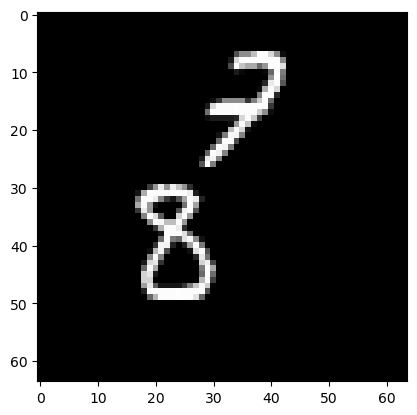

In [14]:
plt.figure()
plt.imshow(z[0][0].permute(1, 2, 0)*0.5 + 0.5, cmap='gray') 
plt.show()

# **MODELS**

## Modules

In [15]:
class BasicConv2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding, transpose=False, act_norm=False):
        super(BasicConv2d, self).__init__()
        self.act_norm=act_norm
        if not transpose:
            self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding)
        else:
            self.conv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding,output_padding=stride //2 )
        self.norm = nn.GroupNorm(2, out_channels)
        self.act = nn.LeakyReLU(0.2, inplace=True)

    def forward(self, x):
        y = self.conv(x)
        if self.act_norm:
            y = self.act(self.norm(y))
        return y


class ConvSC(nn.Module):
    def __init__(self, C_in, C_out, stride, transpose=False, act_norm=True):
        super(ConvSC, self).__init__()
        if stride == 1:
            transpose = False
        self.conv = BasicConv2d(C_in, C_out, kernel_size=3, stride=stride,
                                padding=1, transpose=transpose, act_norm=act_norm)

    def forward(self, x):
        y = self.conv(x)
        return y


class GroupConv2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding, groups, act_norm=False):
        super(GroupConv2d, self).__init__()
        self.act_norm = act_norm
        if in_channels % groups != 0:
            groups = 1
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding,groups=groups)
        self.norm = nn.GroupNorm(groups,out_channels)
        self.activate = nn.LeakyReLU(0.2, inplace=True)
    
    def forward(self, x):
        y = self.conv(x)
        if self.act_norm:
            y = self.activate(self.norm(y))
        return y


class Inception(nn.Module):
    def __init__(self, C_in, C_hid, C_out, incep_ker=[3,5,7,11], groups=8):        
        super(Inception, self).__init__()
        self.conv1 = nn.Conv2d(C_in, C_hid, kernel_size=1, stride=1, padding=0)
        layers = []
        for ker in incep_ker:
            layers.append(GroupConv2d(C_hid, C_out, kernel_size=ker, stride=1, padding=ker//2, groups=groups, act_norm=True))
        self.layers = nn.Sequential(*layers)

    def forward(self, x):
        
        #print(x.shape)
        
        x = self.conv1(x)
        y = 0
        for layer in self.layers:
            y += layer(x)
        return y

MODEL

In [16]:
def stride_generator(N, reverse=False):
    strides = [1, 2]*10
    if reverse: return list(reversed(strides[:N]))
    else: return strides[:N]

class Encoder(nn.Module):
    def __init__(self,C_in, C_hid, N_S):
        super(Encoder,self).__init__()
        strides = stride_generator(N_S)
        self.enc = nn.Sequential(
            ConvSC(C_in, C_hid, stride=strides[0]),
            *[ConvSC(C_hid, C_hid, stride=s) for s in strides[1:]]
        )
    
    def forward(self,x):# B*4, 3, 128, 128
        enc1 = self.enc[0](x)
        latent = enc1
        for i in range(1,len(self.enc)):
            latent = self.enc[i](latent)
        return latent,enc1


class Decoder(nn.Module):
    def __init__(self,C_hid, C_out, N_S):
        super(Decoder,self).__init__()
        strides = stride_generator(N_S, reverse=True)
        self.dec = nn.Sequential(
            *[ConvSC(C_hid, C_hid, stride=s, transpose=True) for s in strides[:-1]],
            ConvSC(2*C_hid, C_hid, stride=strides[-1], transpose=True)
        )
        self.readout = nn.Conv2d(C_hid, C_out, 1)
    
    def forward(self, hid, enc1=None):
        for i in range(0,len(self.dec)-1):
            hid = self.dec[i](hid)
        Y = self.dec[-1](torch.cat([hid, enc1], dim=1))
        Y = self.readout(Y)
        return Y

class Mid_Xnet(nn.Module):
    def __init__(self, channel_in, channel_hid, N_T, incep_ker = [3,5,7,11], groups=8):
        super(Mid_Xnet, self).__init__()

        self.N_T = N_T
        enc_layers = [Inception(channel_in, channel_hid//2, channel_hid, incep_ker= incep_ker, groups=groups)]
        for i in range(1, N_T-1):
            enc_layers.append(Inception(channel_hid, channel_hid//2, channel_hid, incep_ker= incep_ker, groups=groups))
        enc_layers.append(Inception(channel_hid, channel_hid//2, channel_hid, incep_ker= incep_ker, groups=groups))

        dec_layers = [Inception(channel_hid, channel_hid//2, channel_hid, incep_ker= incep_ker, groups=groups)]
        for i in range(1, N_T-1):
            dec_layers.append(Inception(2*channel_hid, channel_hid//2, channel_hid, incep_ker= incep_ker, groups=groups))
        dec_layers.append(Inception(2*channel_hid, channel_hid//2, channel_in, incep_ker= incep_ker, groups=groups))

        self.enc = nn.Sequential(*enc_layers)
        self.dec = nn.Sequential(*dec_layers)

    def forward(self, x):
        B, T, C, H, W = x.shape
        #print('E', x.shape)
        x = x.reshape(B, T*C, H, W)
        #print('RE', x.shape)
        
        # encoder
        skips = []
        
        for i in range(self.N_T):
            #print('skip', x.shape)
            x = self.enc[i](x)
            #print('skip', x.shape)
            if i < self.N_T - 1:
                skips.append(x)

        # decoder
        z = self.dec[0](x)
        for i in range(1, self.N_T):
            x = self.dec[i](torch.cat([x, skips[-i]], dim=1))

        y = x.reshape(B, T, C, H, W)
        return y


class SimVP(nn.Module):
    def __init__(self, shape_in, hid_S=16, hid_T=256, N_S=4, N_T=8, incep_ker=[3,5,7,11], groups=8):
        super(SimVP, self).__init__()
        T, C, H, W = shape_in
        self.enc = Encoder(C, hid_S, N_S)
        self.hid = Mid_Xnet(T*hid_S, hid_T, N_T, incep_ker, groups)
        self.dec = Decoder(hid_S, C, N_S)


    def forward(self, x_raw):
        #print(x_raw.shape)
        B, T, C, H, W = x_raw.shape
        x = x_raw.view(B*T, C, H, W)

        embed, skip = self.enc(x)
        _, C_, H_, W_ = embed.shape

        z = embed.view(B, T, C_, H_, W_)
        #print(z.shape)
        hid = self.hid(z)
        hid = hid.reshape(B*T, C_, H_, W_)

        Y = self.dec(hid, skip)
        Y = Y.reshape(B, T, C, H, W)
        return Y

# **TRAINER TESTER**

In [17]:
def evaluation_proper(test_loader, model):
    out_len = 10
    print('Evaluating...')
    
    loss_fn = lpips.LPIPS(net='alex', spatial=True).to(configs.device)
    mse_list = np.empty((len(test_loader), out_len))
    mae_list = np.empty((len(test_loader), out_len))
    ssim_list = np.empty((len(test_loader), out_len))
    psnr_list = np.empty((len(test_loader), out_len))
    lpips_list = np.empty((len(test_loader), out_len))
    
    total_mse = 0
    total_mae = 0
    
    with torch.no_grad():
        model.eval()
        for i, x in tqdm(enumerate(test_loader, 0), total=len(test_loader)):
            batch_x = x[:, :10].to(opt.device)
            batch_y = x[:, 10:].to(opt.device)

            pred_y = model(batch_x)

            target = batch_y.detach().cpu().numpy().transpose(0,1, 3, 4, 2)
            predictions = pred_y.detach().cpu().numpy().transpose(0, 1, 3, 4, 2)
            
            #print(target.shape)
            #print(predictions.shape)
            predictions[predictions < 0.10] = 0
            predictions[predictions > 0.99] = 1
            
            if (i+1) % 200 == 0:
                print(target[0, 1, 40:42, 40:42, 0])
                print(predictions[0, 1, 40:42, 40:42, 0])
                fig, ax = plt.subplots(2, out_len, figsize=(25, 7))
                for i in range(2):
                    for j in range(out_len):
                        if i == 0:
                            ax[i][j].imshow(target[0][j])
                            ax[i][j].set_title('V Ground Truth')
                        if i == 1:
                            ax[i][j].imshow(predictions[0][j])
                            ax[i][j].set_title('V Generated')
                        ax[i][j].axis('off')
                plt.show()
            
            mse_batch = np.mean((predictions-target)**2 , axis=(0,1,4)).sum()
            mae_batch = np.mean(np.abs(predictions-target),  axis=(0,1,4)).sum() 
            total_mse += mse_batch
            total_mae += mae_batch
            
            for j in range(out_len):
                mse_list[i][j] = np.square(predictions[:,j,:,:,:] - target[:,j,:,:,:]).mean()
                mae_list[i][j] = np.abs(predictions[:,j,:,:,:] - target[:,j,:,:,:]).mean()
                ssim_list[i][j] = ssim(target[0,j,:,:,0], predictions[0,j,:,:,0], multichannel=False)
                psnr_list[i][j] = 20 * np.log10(1 / sqrt(mse_list[i][j]))
                t1 = torch.from_numpy((predictions[:,j,:,:,:] - 0.5) / 0.5).to(configs.device).permute((0, 3, 1, 2))
                t2 = torch.from_numpy((target[:,j,:,:,:] - 0.5) / 0.5).to(configs.device).permute((0, 3, 1, 2))
                d = loss_fn.forward(t1, t2)
                lpips_list[i][j] = d.mean().detach().cpu().numpy() * 100
                    
        model.train()
        
    avg_mse_frame = mse_list.mean(axis=0)
    avg_mae_frame = mae_list.mean(axis=0)
    avg_ssim_frame = ssim_list.mean(axis=0)
    avg_psnr_frame = psnr_list.mean(axis=0)
    avg_lpips_frame = lpips_list.mean(axis=0)

    avg_mse = mse_list.mean()
    avg_mae = mae_list.mean()
    avg_ssim = ssim_list.mean()
    avg_psnr = psnr_list.mean()
    avg_lpips = lpips_list.mean()

    print('Eval MSE: ', total_mse/(len(test_loader)))
    print('Eval MAE: ', total_mae/(len(test_loader)))
    
    print(f'Avg-MSE: {avg_mse}\nMSE/Frame: {avg_mse_frame}')
    print(f'Avg-MAE: {avg_mae}\nMAE/Frame: {avg_mae_frame}')
    print(f'Avg-SSIM: {avg_ssim}\nSSIM/Frame: {avg_ssim_frame}')
    print(f'Avg-PSNR: {avg_psnr}\nPSNR/Frame: {avg_psnr_frame}')
    print(f'Avg-LPIPS: {avg_lpips}\nLPIPS/Frame: {avg_lpips_frame}')
    
    return avg_mse

In [18]:
#evaluation_proper(test_loader)

# **MODEL FACTORY**

In [19]:
class Model(object):
    def __init__(self, configs):
        self.configs = configs
        self.patch_height = configs.img_height // configs.patch_size
        self.patch_width = configs.img_width // configs.patch_size
        self.patch_channel = configs.img_channel * (configs.patch_size ** 2)
        self.num_layers = configs.num_layers
        networks_map = {
            'predv2': RNN,
        }
        num_hidden = []
        for i in range(configs.num_layers):
            num_hidden.append(configs.num_hidden)
        self.num_hidden = num_hidden
        if configs.model_name in networks_map:
            Network = networks_map[configs.model_name]
            self.network = Network(self.num_layers, self.num_hidden, configs).to(configs.device)
        else:
            raise ValueError('Name of network unknown %s' % configs.model_name)

        self.optimizer = Adam(self.network.parameters(), lr=configs.lr)
        self.MSE_criterion = nn.MSELoss()
        self.L1_loss = nn.L1Loss()

    def save(self, itr):
        stats = {'net_param': self.network.state_dict()}
        checkpoint_path = os.path.join(self.configs.save_dir, 'model.ckpt' + '-' + str(itr))
        torch.save(stats, checkpoint_path)
        print("save predictive model to %s" % checkpoint_path)

    def load(self, pm_checkpoint_path):
        print('load predictive model:', pm_checkpoint_path)
        stats = torch.load(pm_checkpoint_path, map_location=torch.device(self.configs.device))
        self.network.load_state_dict(stats['net_param'])

    def train(self, data, mask, itr, val):
        frames = data
        self.network.train()
        val_tensor = torch.FloatTensor(val).to(self.configs.device)
        frames_tensor = torch.FloatTensor(frames).to(self.configs.device)
        mask_tensor = torch.FloatTensor(mask).to(self.configs.device)

        if(self.configs.verbose):
            print('FT', frames_tensor.shape)
            print('MT', mask_tensor.shape)
        
        next_frames, loss1, loss2 = self.network(frames_tensor, mask_tensor)
        loss = loss1 + loss2
        if(self.configs.verbose):
            print('Next Frames', next_frames.shape)
            
        #next_frames = next_frames.permute(0, 1, 4, 2, 3)

        ground_truth = frames_tensor
        if(self.configs.verbose):
            print('Ground', ground_truth[:, 1:].shape)

            
        
        if itr % configs.plot_interval == 0:
            with torch.no_grad():
                self.network.eval()
                x = frames_tensor[0][0:configs.input_length]
                y = frames_tensor[0][configs.input_length:]
                g = next_frames[0][configs.input_length-1:]
                m = mask_tensor[0]
                fig, ax = plt.subplots(4, configs.input_length, figsize=(25, 10))
                for i in range(4):
                    for j in range(configs.input_length):
                        if i == 0:
                            ax[i][j].imshow(x[j].to('cpu').permute(1, 2, 0))
                            ax[i][j].set_title('T Input')
                        if i == 1:
                            if j == configs.input_length-1:
                                ax[i][j].axis('off')
                                continue
                            ax[i][j].imshow(m[j].to('cpu'))
                            ax[i][j].set_title('T Mask')
                        if i == 2:
                            ax[i][j].imshow(y[j].to('cpu').permute(1, 2, 0))
                            ax[i][j].set_title('T Ground Truth')
                        if i == 3:
                            ax[i][j].imshow(g[j].detach().to('cpu').permute(1, 2, 0))
                            ax[i][j].set_title('T Generated')
                        ax[i][j].axis('off')


#                 x = val_tensor[0][0:configs.input_length]
#                 y = val_tensor[0][configs.input_length:]
#                 mask = torch.zeros_like(mask_tensor[0]).unsqueeze(0).to(configs.device)
#                 next_frameszz = self.network(val_tensor, mask)
#                 m = mask[0]
#                 g = next_frameszz[0][configs.input_length-1:]
#                 fig, ax = plt.subplots(4, configs.input_length, figsize=(25, 10))
#                 for i in range(4):
#                     for j in range(configs.input_length):
#                         if i == 0:
#                             ax[i][j].imshow(x[j].to('cpu').permute(1, 2, 0))
#                             ax[i][j].set_title('V Input')
#                         if i == 1:
#                             if j == configs.input_length-1:
#                                 ax[i][j].axis('off')
#                                 continue
#                             ax[i][j].imshow(m[j].to('cpu'))
#                             ax[i][j].set_title('V Mask')
#                         if i == 2:
#                             ax[i][j].imshow(y[j].to('cpu').permute(1, 2, 0))
#                             ax[i][j].set_title('V Ground Truth')
#                         if i == 3:
#                             ax[i][j].imshow(g[j].detach().to('cpu').permute(1, 2, 0))
#                             ax[i][j].set_title('V Generated')
#                         ax[i][j].axis('off')
                
                self.network.train()
            
                    
            
        batch_size = next_frames.shape[0]

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

#         if itr >= self.configs.sampling_stop_iter and itr % self.configs.delay_interval == 0:
#             self.scheduler.step()
#             # self.scheduler_F.step()
#             # self.scheduler_D.step()
#             print('LR decay to:%.8f', self.optimizer.param_groups[0]['lr'])

        return next_frames, loss1.detach().cpu().numpy(), loss2.detach().cpu().numpy()

    def test(self, data, mask):
        frames = data
        self.network.eval()
        frames_tensor = torch.FloatTensor(frames).to(self.configs.device)
        mask_tensor = torch.FloatTensor(mask).to(self.configs.device)
        next_frames, loss1, loss2 = self.network(frames_tensor, mask_tensor)
        return next_frames.detach().cpu().numpy()

EXPERIMENT FACTORY

In [20]:
class Exp:
    def __init__(self, args):
        super(Exp, self).__init__()
        self.args = args
        self.config = self.args.__dict__
        self.device = self._acquire_device()

        self._preparation()
        #print_log(output_namespace(self.args))

        #self._get_data()
        self._select_optimizer()
        self._select_criterion()

    def _acquire_device(self):
        if self.args.use_gpu:
            os.environ["CUDA_VISIBLE_DEVICES"] = str(self.args.gpu)
            device = torch.device('cuda:{}'.format(0))
            #print_log('Use GPU: {}'.format(self.args.gpu))
        else:
            device = torch.device('cpu')
            #print_log('Use CPU')
        return device

    def _preparation(self):
        # seed
        #set_seed(self.args.seed)
        # log and checkpoint
        self.path = os.path.join(self.args.res_dir, self.args.ex_name)
        check_dir(self.path)

        self.checkpoints_path = os.path.join(self.path, 'checkpoints')
        check_dir(self.checkpoints_path)

        sv_param = os.path.join(self.path, 'model_param.json')
        with open(sv_param, 'w') as file_obj:
            json.dump(self.args.__dict__, file_obj)

#         for handler in logging.root.handlers[:]:
#             logging.root.removeHandler(handler)
#         logging.basicConfig(level=logging.INFO, filename=osp.join(self.path, 'log.log'),
#                             filemode='a', format='%(asctime)s - %(message)s')
        # prepare data
        #self._get_data()
        # build the model
        self._build_model()

    def _build_model(self):
        args = self.args
        self.model = SimVP(tuple(args.in_shape), args.hid_S,
                           args.hid_T, args.N_S, args.N_T).to(self.device)

    def _get_data(self):
        config = self.args.__dict__
        self.train_loader, self.vali_loader, self.test_loader, self.data_mean, self.data_std = load_data(**config)
        self.vali_loader = self.test_loader if self.vali_loader is None else self.vali_loader

    def _select_optimizer(self):
        self.optimizer = torch.optim.Adam(
            self.model.parameters(), lr=self.args.lr)
        self.scheduler = torch.optim.lr_scheduler.OneCycleLR(
            self.optimizer, max_lr=self.args.lr, steps_per_epoch=len(train_loader), epochs=self.args.epochs)
        return self.optimizer

    def _select_criterion(self):
        self.criterion = torch.nn.MSELoss()

    def _save(self, name=''):
        torch.save(self.model.state_dict(), os.path.join(
            self.checkpoints_path, name + '.pth'))
        state = self.scheduler.state_dict()
        fw = open(os.path.join(self.checkpoints_path, name + '.pkl'), 'wb')
        pickle.dump(state, fw)

    def train(self, args):
        config = args.__dict__
        #recorder = Recorder(verbose=True)

        for epoch in range(100):
            train_loss = []
            self.model.train()

            for bi, batcher in tqdm(enumerate(train_loader), total=len(train_loader)):
                batch_x = batcher[:, :10].to(self.device)
                batch_y = batcher[:, 10:].to(self.device)
                self.optimizer.zero_grad()
                pred_y = self.model(batch_x)
                
                #print(pred_y.shape)
                
                loss = self.criterion(pred_y, batch_y)
                train_loss.append(loss.item())
                
                if bi % 100 == 0:
                    with torch.no_grad():
                        self.model.eval()
                        x = batch_x[0]
                        y = batch_y[0]
                        g = pred_y[0]
                        fig, ax = plt.subplots(3, configs.input_length, figsize=(25, 10))
                        for i in range(3):
                            for j in range(configs.input_length):
                                if i == 0:
                                    ax[i][j].imshow(x[j].to('cpu').permute(1, 2, 0), cmap='gray')
                                    ax[i][j].set_title('T Input')
                                if i == 1:
                                    ax[i][j].imshow(y[j].to('cpu').permute(1, 2, 0), cmap='gray')
                                    ax[i][j].set_title('T Ground Truth')
                                if i == 2:
                                    ax[i][j].imshow(g[j].detach().to('cpu').permute(1, 2, 0), cmap='gray')
                                    ax[i][j].set_title('T Generated')
                                ax[i][j].axis('off')


        #                 x = val_tensor[0][0:configs.input_length]
        #                 y = val_tensor[0][configs.input_length:]
        #                 mask = torch.zeros_like(mask_tensor[0]).unsqueeze(0).to(configs.device)
        #                 next_frameszz = self.network(val_tensor, mask)
        #                 m = mask[0]
        #                 g = next_frameszz[0][configs.input_length-1:]
        #                 fig, ax = plt.subplots(4, configs.input_length, figsize=(25, 10))
        #                 for i in range(4):
        #                     for j in range(configs.input_length):
        #                         if i == 0:
        #                             ax[i][j].imshow(x[j].to('cpu').permute(1, 2, 0))
        #                             ax[i][j].set_title('V Input')
        #                         if i == 1:
        #                             if j == configs.input_length-1:
        #                                 ax[i][j].axis('off')
        #                                 continue
        #                             ax[i][j].imshow(m[j].to('cpu'))
        #                             ax[i][j].set_title('V Mask')
        #                         if i == 2:
        #                             ax[i][j].imshow(y[j].to('cpu').permute(1, 2, 0))
        #                             ax[i][j].set_title('V Ground Truth')
        #                         if i == 3:
        #                             ax[i][j].imshow(g[j].detach().to('cpu').permute(1, 2, 0))
        #                             ax[i][j].set_title('V Generated')
        #                         ax[i][j].axis('off')

                        self.model.train()
                    plt.show()
                    

                loss.backward()
                self.optimizer.step()

            train_loss = np.average(train_loss)
            
            print(f'E:{epoch}, TL:{train_loss}')
            
            if (epoch+1)%10==0:
                evaluation_proper(test_loader, exp.model)
                torch.save(self.model.state_dict(), 'saves/simpvp.pth')
                #best_model_path = self.path + '/' + 'checkpoint.pth'
                #self.model.load_state_dict(torch.load(best_model_path))
#         return self.model

#             if epoch % args.log_step == 0:
#                 with torch.no_grad():
#                     #vali_loss = self.vali(self.vali_loader)
#                     if epoch % (args.log_step * 100) == 0:
#                         self._save(name=str(epoch))
#                 print_log("Epoch: {0} | Train Loss: {1:.4f} Vali Loss: {2:.4f}\n".format(
#                     epoch + 1, train_loss, vali_loss))
#                 #recorder(vali_loss, self.model, self.path)



    def vali(self, vali_loader):
        self.model.eval()
        preds_lst, trues_lst, total_loss = [], [], []
        vali_pbar = tqdm(vali_loader)
        for i, (batch_x, batch_y) in enumerate(vali_pbar):
            if i * batch_x.shape[0] > 1000:
                break

            batch_x, batch_y = batch_x.to(self.device), batch_y.to(self.device)
            pred_y = self.model(batch_x)
            list(map(lambda data, lst: lst.append(data.detach().cpu().numpy()), [
                 pred_y, batch_y], [preds_lst, trues_lst]))

            loss = self.criterion(pred_y, batch_y)
            vali_pbar.set_description(
                'vali loss: {:.4f}'.format(loss.mean().item()))
            total_loss.append(loss.mean().item())

        total_loss = np.average(total_loss)
        preds = np.concatenate(preds_lst, axis=0)
        trues = np.concatenate(trues_lst, axis=0)
        mse, mae, ssim, psnr = metric(preds, trues, vali_loader.dataset.mean, vali_loader.dataset.std, True)
        print_log('vali mse:{:.4f}, mae:{:.4f}, ssim:{:.4f}, psnr:{:.4f}'.format(mse, mae, ssim, psnr))
        self.model.train()
        return total_loss

    def test(self, args):
        self.model.eval()
        inputs_lst, trues_lst, preds_lst = [], [], []
        for batch_x, batch_y in self.test_loader:
            pred_y = self.model(batch_x.to(self.device))
            list(map(lambda data, lst: lst.append(data.detach().cpu().numpy()), [
                 batch_x, batch_y, pred_y], [inputs_lst, trues_lst, preds_lst]))

        inputs, trues, preds = map(lambda data: np.concatenate(
            data, axis=0), [inputs_lst, trues_lst, preds_lst])

        folder_path = self.path+'/results/{}/sv/'.format(args.ex_name)
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)

        mse, mae, ssim, psnr = metric(preds, trues, self.test_loader.dataset.mean, self.test_loader.dataset.std, True)
        print_log('mse:{:.4f}, mae:{:.4f}, ssim:{:.4f}, psnr:{:.4f}'.format(mse, mae, ssim, psnr))

        for np_data in ['inputs', 'trues', 'preds']:
            np.save(osp.join(folder_path, np_data + '.npy'), vars()[np_data])
        return mse

# **CONFIG**

In [21]:
class Configuration:
    def __init__(self):
        super(Configuration, self).__init__()
        self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.data_train_path = '../input/moving-mnist/mnist_test_seq.npy'
        self.data_test_path = '../input/kthextract-to-jpg/data/test'
        self.input_length = 10
        self.real_length = 20
        self.total_length = 20
        self.img_height = 64
        self.img_width = 64
        self.sr_size = 4
        self.img_channel = 1
        self.patch_size = 1
        self.alpha = 1
        self.model_name = 'predv2'
        self.dataset = 'mmnist'
        self.cell_mode = 'residual'
        self.model_mode = 'recall'
        self.num_workers = 2
        self.num_hidden = 32
        self.num_layers = 2
        self.num_heads = 2
        self.filter_size = 5
        self.stride = 1
        self.time = 2
        self.time_stride = 1
        self.tau = 7
        self.is_training = True
        self.lr = 1e-3
        self.lr_decay = 0.90
        self.delay_interval = 2000
        self.batch_size = 32
        self.max_iterations = 150000
        self.max_epoches = 100
        self.display_interval = 150
        self.plot_interval = 150
        self.test_interval = 1010
        self.snapshot_interval = 1000
        self.num_save_samples = 3
        self.n_gpu = 1
        self.pretrained_model = ''
        self.perforamnce_dir = 'results/mmnist'
        self.save_dir = 'saves/mmnist'
        self.gen_frm_dir = 'results/mmnist/'
        self.scheduled_sampling = True
        self.sampling_stop_iter = 50000
        self.sampling_start_value = 1.0
        self.sampling_changing_rate = 0.000005
        self.verbose = False
        self.visual = 0
        self.visual_path=''
        self.layer_norm=0
        self.reverse_scheduled_sampling=0
        self.decouple_beta=0.1
        
configs = Configuration()
args = configs

In [22]:
class Configuration3:
    def __init__(self):
        super(Configuration3, self).__init__()
        self.device='cuda'
        self.res_dir='./results'
        self.ex_name='Debug'
        self.use_gpu=True
        self.gpu=0
        self.seed=1

        self.batch_size=16
#         self.val_batch_size=16
#         self.data_root='./data/')
#         self.dataname='mmnist', choices=['mmnist', 'taxibj'])
#         self.num_workers=2

        # model parameters
        self.in_shape=[10, 1, 64, 64] # [10, 1, 64, 64] for mmnist, [4, 2, 32, 32] for taxibj  
        self.hid_S=64
        self.hid_T=256
        self.N_S=4
        self.N_T=8
        self.groups=4

        # Training parameters
        self.epochs=80
        self.log_step=1
        self.lr=0.01
        
opt = Configuration3()

In [23]:
# DATASET
dataset = TimeSeriesDatasetNpz(root_dir=configs.data_train_path, n_frames_input=10, n_frames_output=10)

# DATA LOADER + SPLIT
validation_split = .3
shuffle_dataset = True
random_seed= 1000

dataset_size = len(dataset)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))
if shuffle_dataset :
    np.random.seed(random_seed)
    np.random.shuffle(indices)
train_indices, val_indices = indices[split:], indices[:split]

# Creating PT data samplers and loaders:
train_sampler = SubsetRandomSampler(train_indices)
valid_sampler = SubsetRandomSampler(val_indices)
train_loader = torch.utils.data.DataLoader(dataset, opt.batch_size, sampler=train_sampler, num_workers=2, pin_memory=True, drop_last=True)
test_loader = torch.utils.data.DataLoader(dataset, 4, sampler=valid_sampler, drop_last=True)

# **TRAIN**

In [24]:
if not os.path.exists('saves'):
    os.makedirs('saves')
# if not os.path.exists(opt.model_dir):
#     os.makedirs(opt.model_dir)
# if not os.path.exists(opt.log_dir):
#     os.makedirs(opt.log_dir)

In [25]:
exp = Exp(opt)

In [26]:
#evaluation_proper(test_loader, exp.model)

  0%|          | 0/437 [00:00<?, ?it/s]

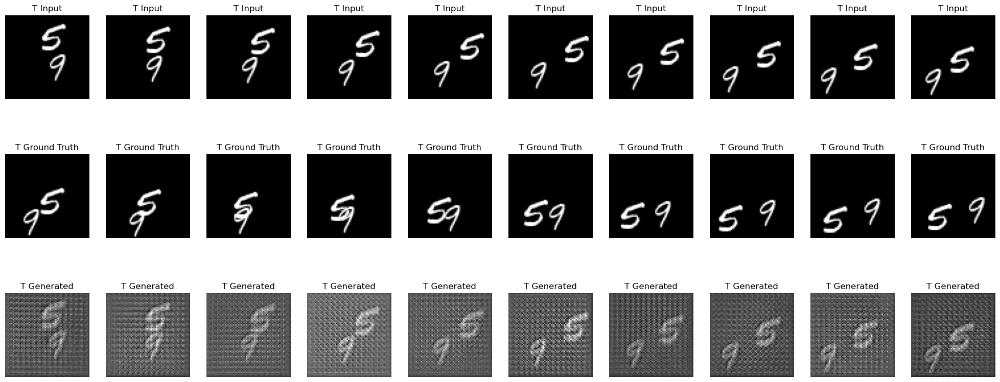

 23%|██▎       | 100/437 [00:39<01:58,  2.85it/s]

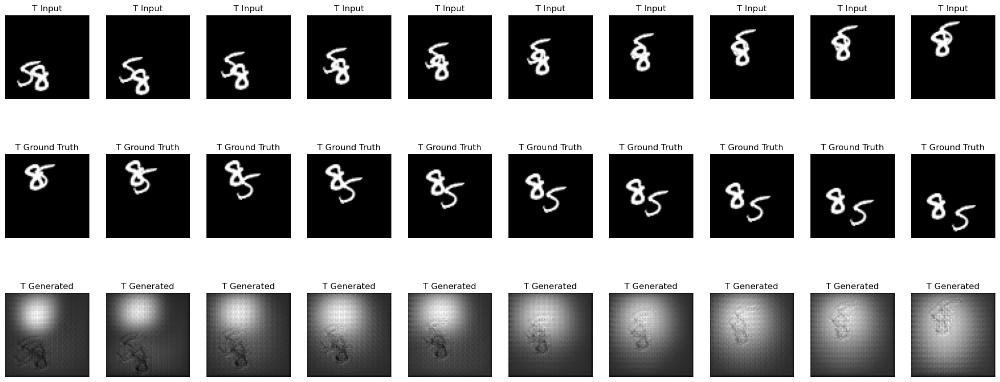

 46%|████▌     | 200/437 [01:15<01:22,  2.86it/s]

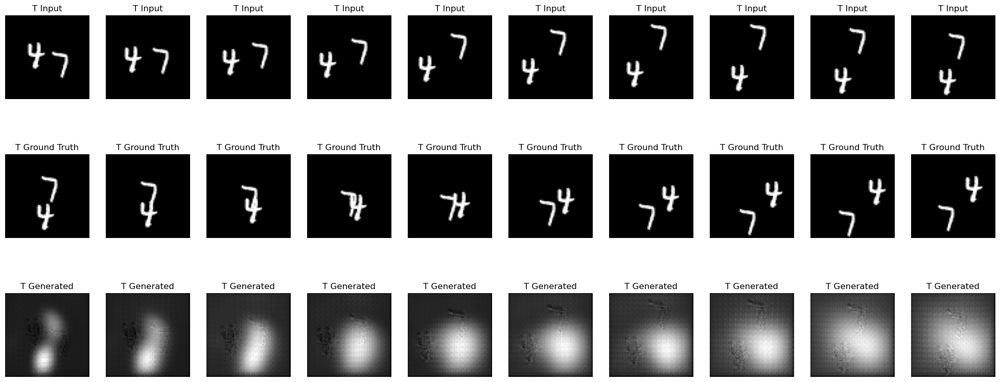

 69%|██████▊   | 300/437 [01:51<00:48,  2.85it/s]

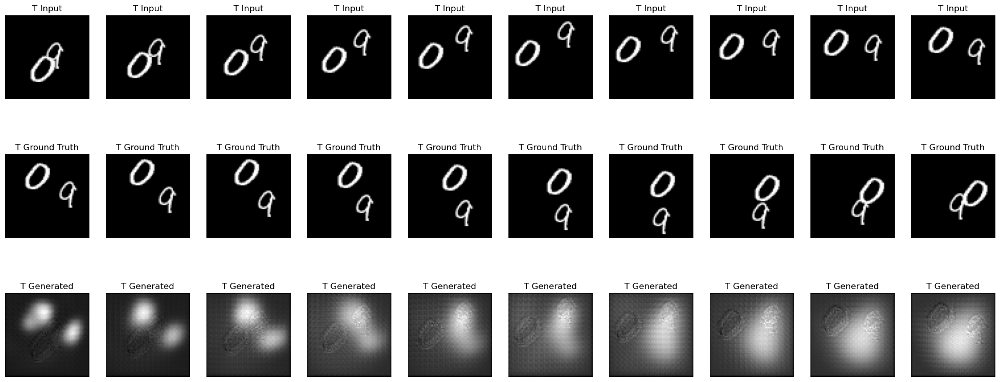

 92%|█████████▏| 400/437 [02:28<00:12,  2.85it/s]

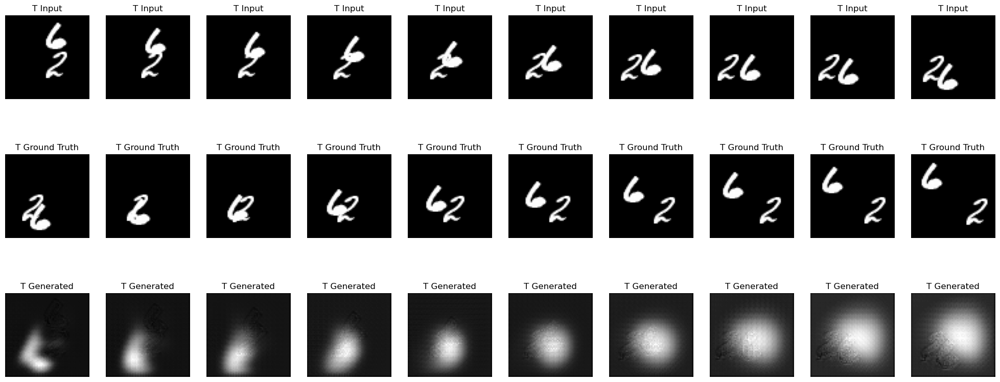

100%|██████████| 437/437 [02:42<00:00,  2.69it/s]

E:0, TL:0.03810907213669484



  0%|          | 0/437 [00:00<?, ?it/s]

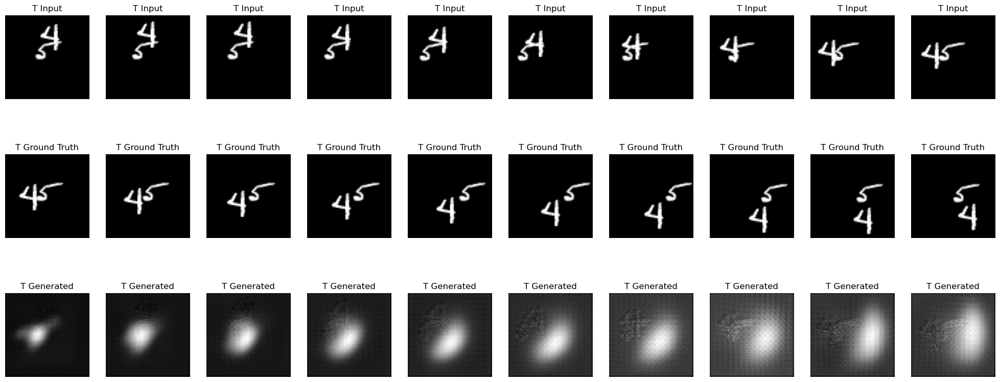

 23%|██▎       | 100/437 [00:36<01:59,  2.82it/s]

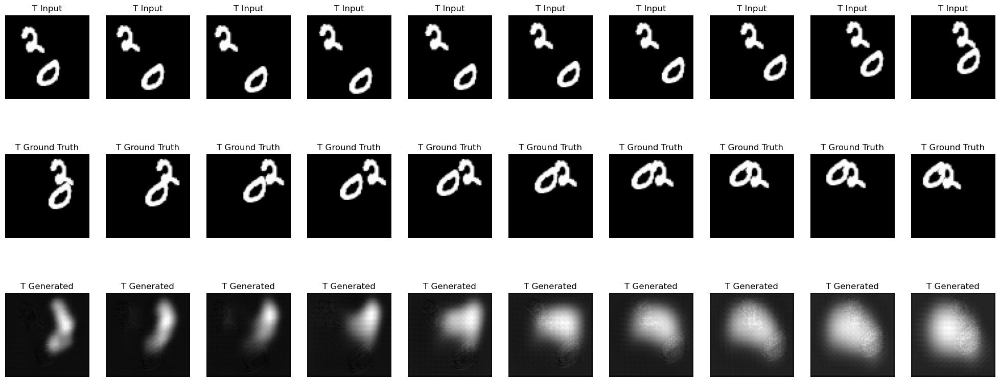

 46%|████▌     | 200/437 [01:12<01:22,  2.86it/s]

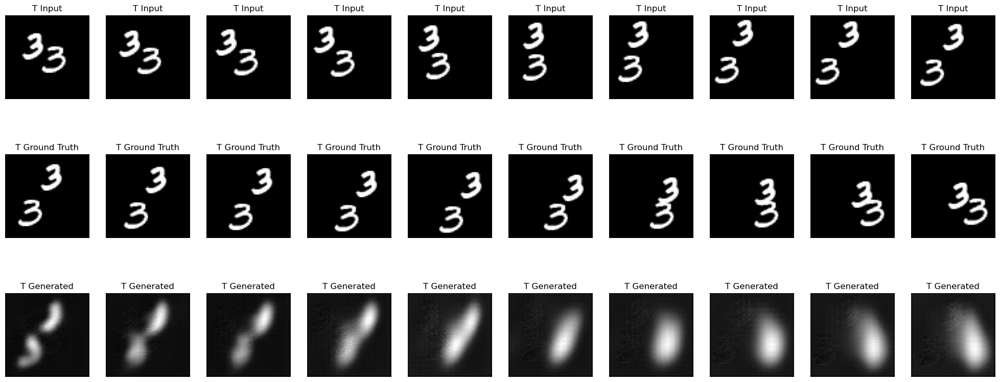

 69%|██████▊   | 300/437 [01:49<00:48,  2.85it/s]

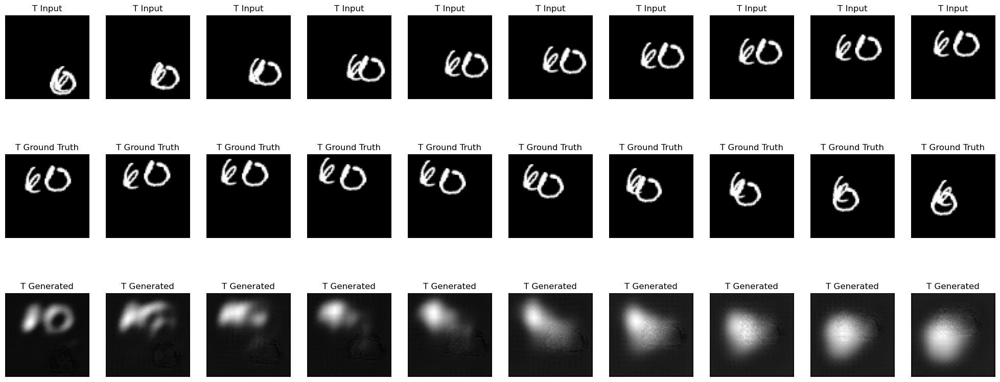

 92%|█████████▏| 400/437 [02:25<00:12,  2.86it/s]

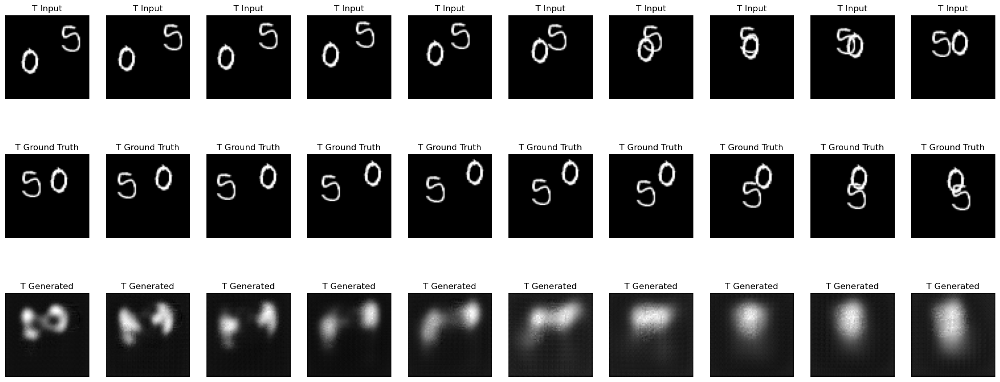

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:1, TL:0.029738100360678317



  0%|          | 0/437 [00:00<?, ?it/s]

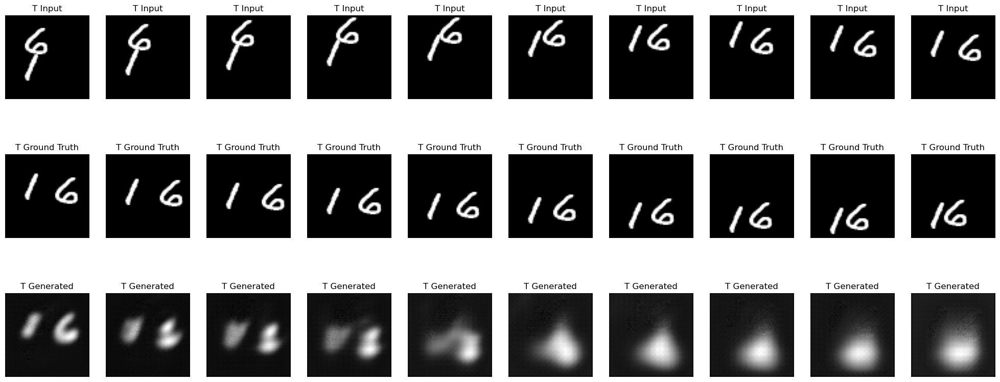

 23%|██▎       | 100/437 [00:36<01:57,  2.86it/s]

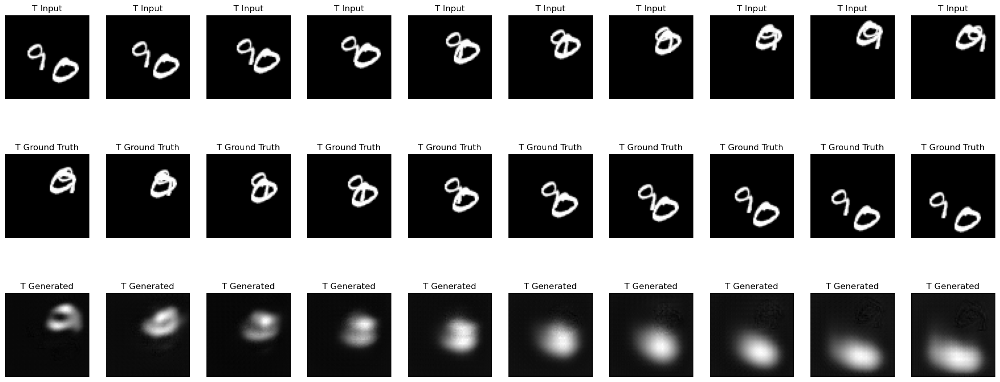

 46%|████▌     | 200/437 [01:12<01:22,  2.86it/s]

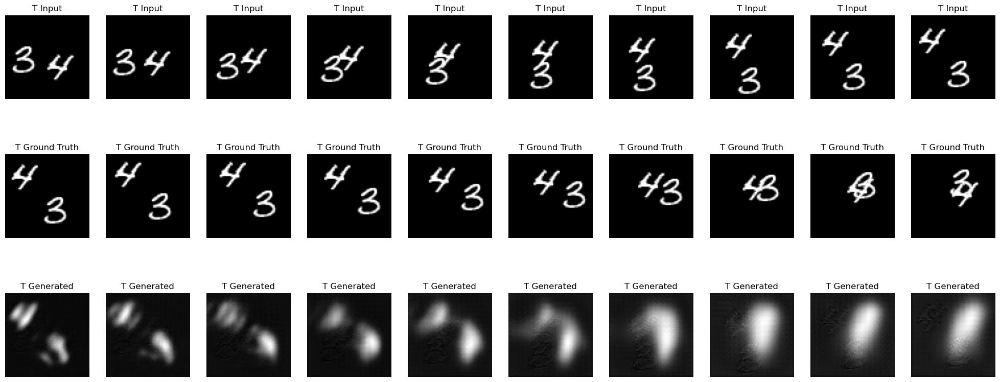

 69%|██████▊   | 300/437 [01:48<00:48,  2.84it/s]

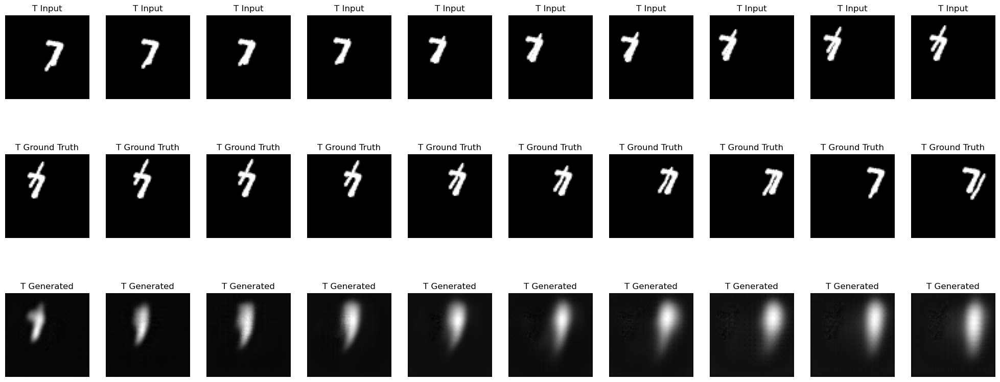

 92%|█████████▏| 400/437 [02:25<00:12,  2.86it/s]

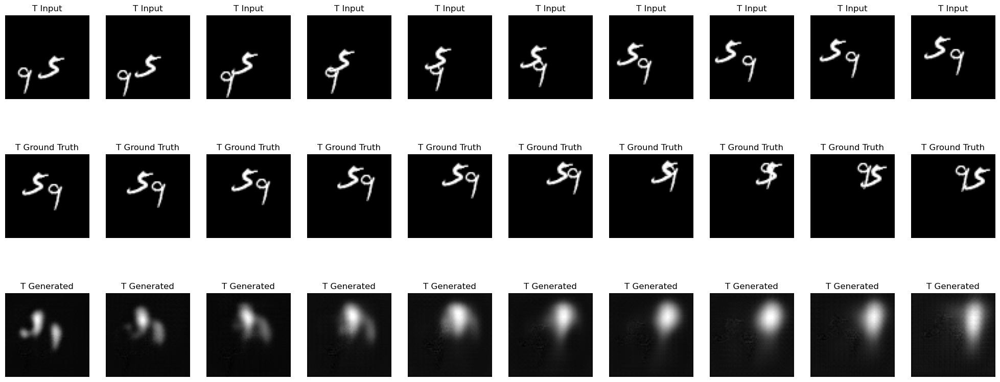

100%|██████████| 437/437 [02:39<00:00,  2.75it/s]

E:2, TL:0.028175832699447255



  0%|          | 0/437 [00:00<?, ?it/s]

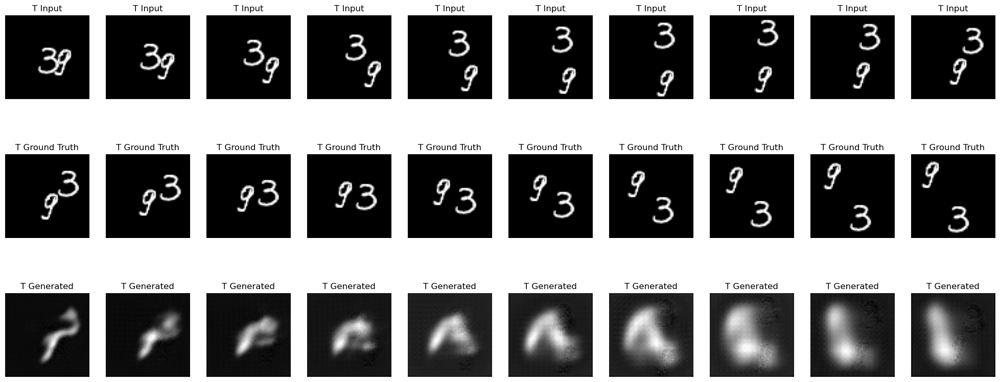

 23%|██▎       | 100/437 [00:36<01:58,  2.84it/s]

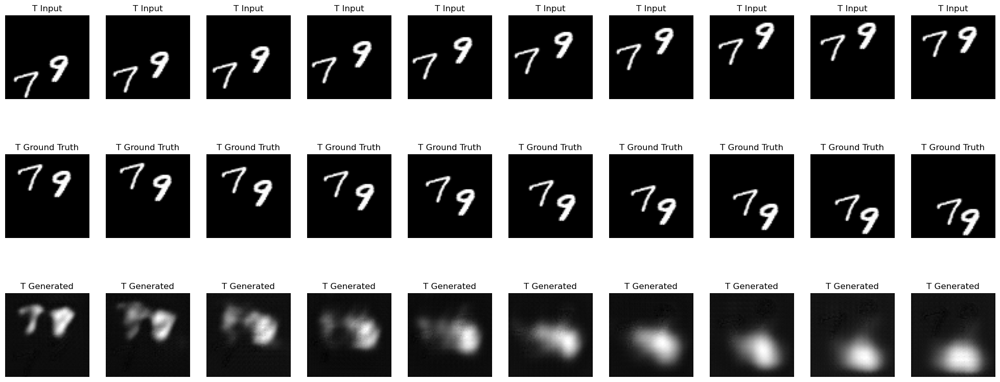

 46%|████▌     | 200/437 [01:12<01:22,  2.86it/s]

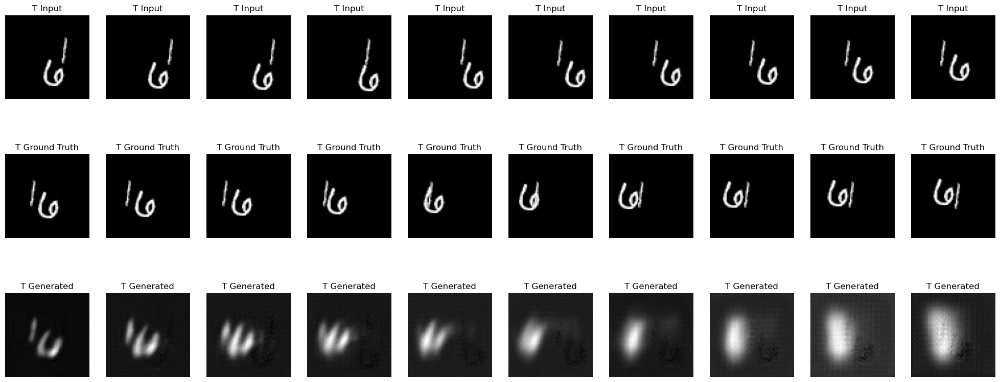

 69%|██████▊   | 300/437 [01:48<00:47,  2.86it/s]

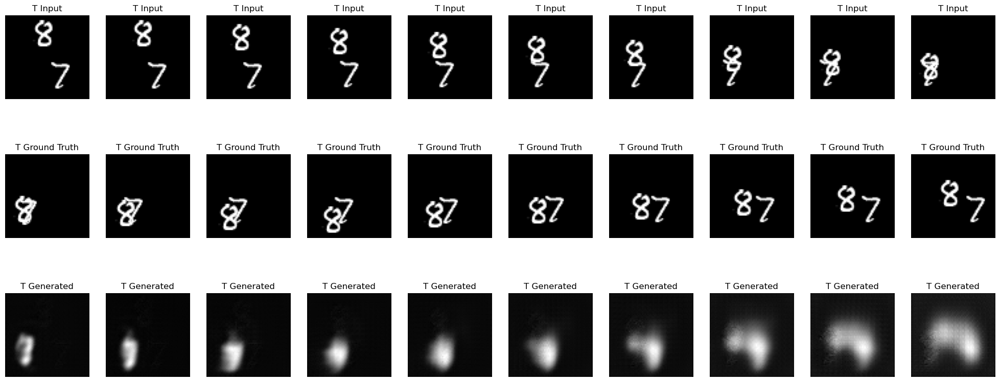

 92%|█████████▏| 400/437 [02:25<00:12,  2.86it/s]

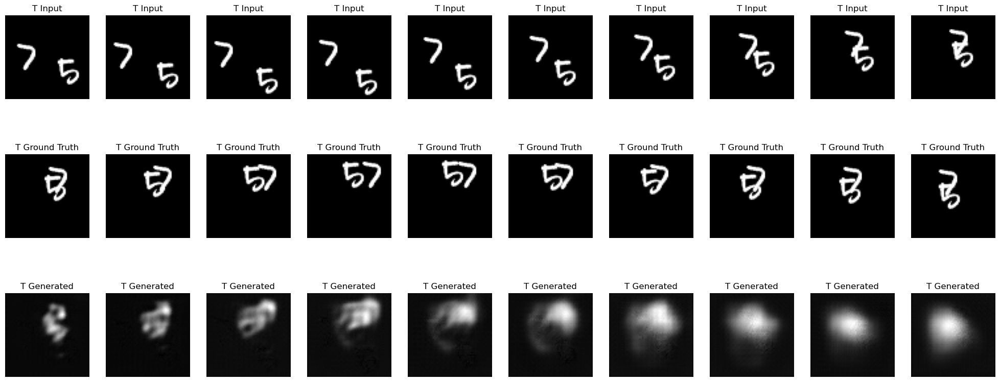

100%|██████████| 437/437 [02:40<00:00,  2.72it/s]

E:3, TL:0.02715979192567908



  0%|          | 0/437 [00:00<?, ?it/s]

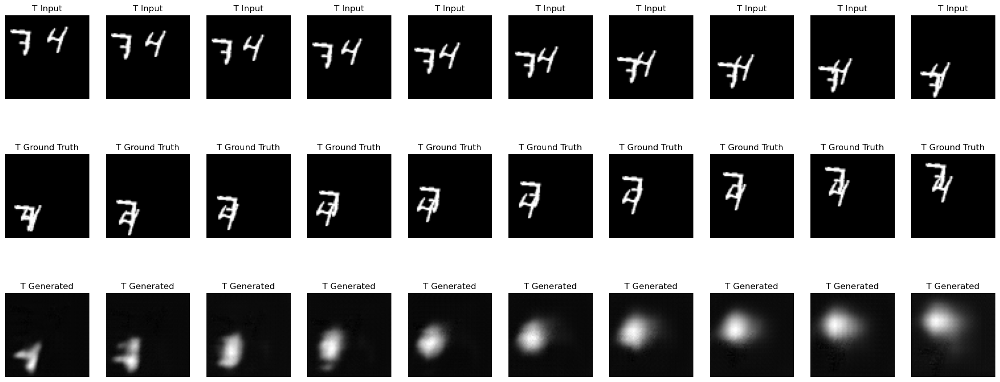

 23%|██▎       | 100/437 [00:36<01:57,  2.87it/s]

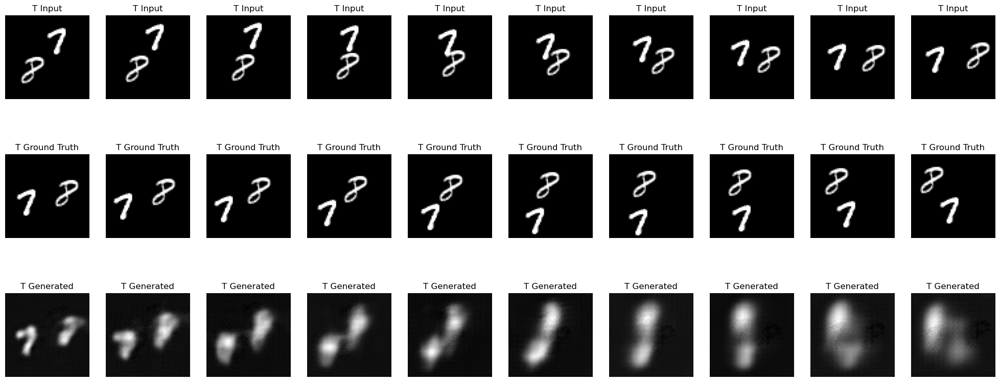

 46%|████▌     | 200/437 [01:13<01:23,  2.85it/s]

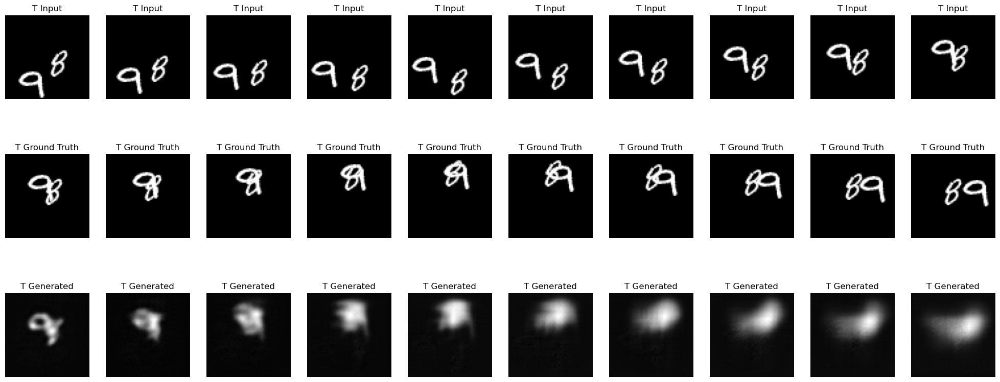

 69%|██████▊   | 300/437 [01:49<00:48,  2.84it/s]

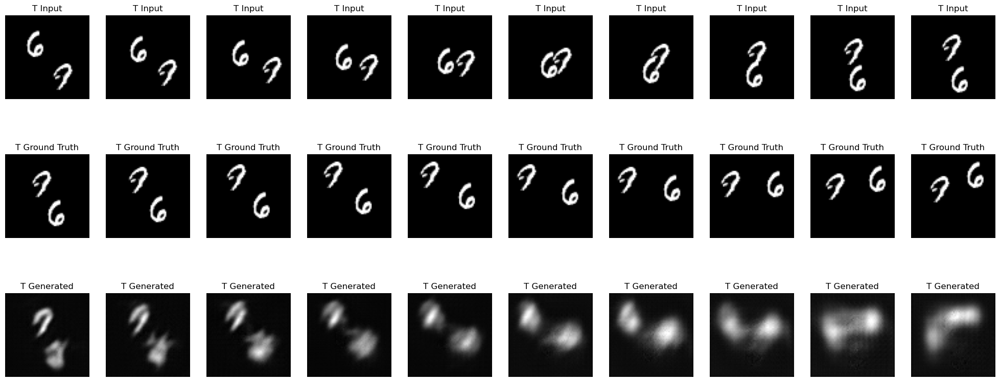

 92%|█████████▏| 400/437 [02:25<00:12,  2.86it/s]

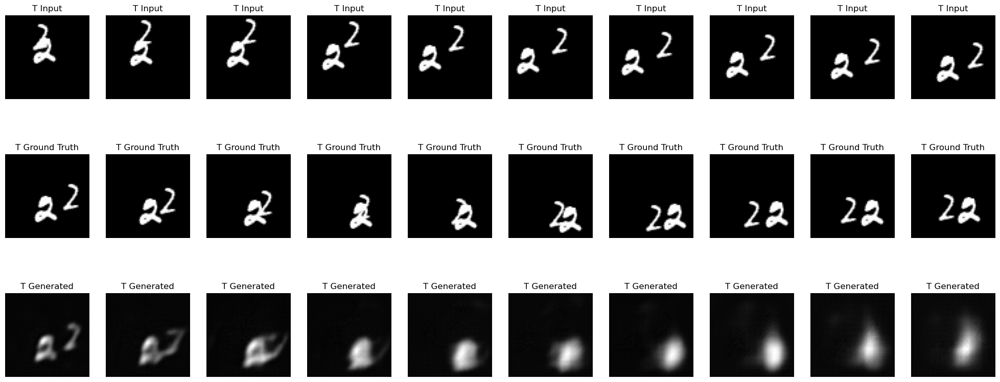

100%|██████████| 437/437 [02:39<00:00,  2.73it/s]

E:4, TL:0.02624697810639915



  0%|          | 0/437 [00:00<?, ?it/s]

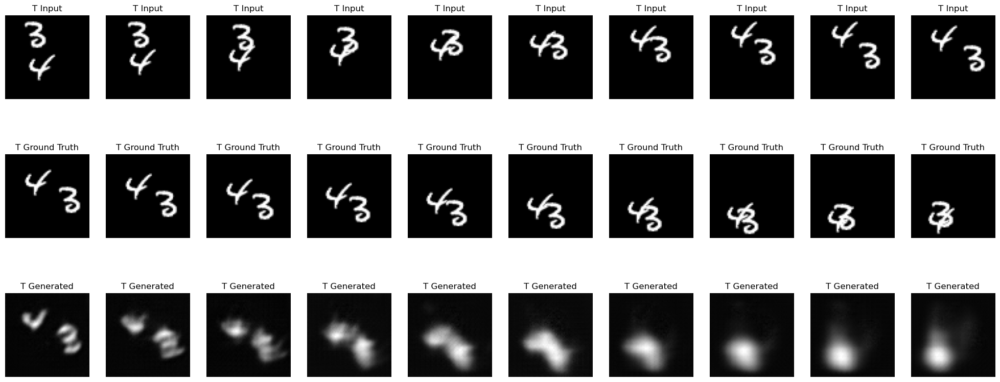

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

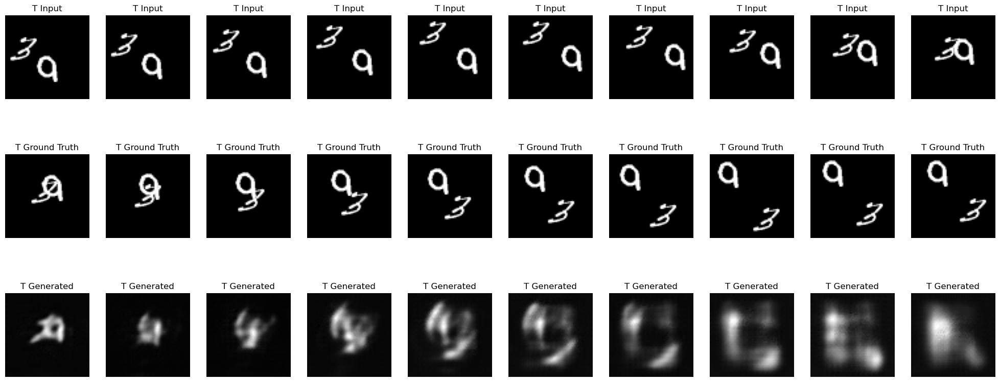

 46%|████▌     | 200/437 [01:12<01:23,  2.85it/s]

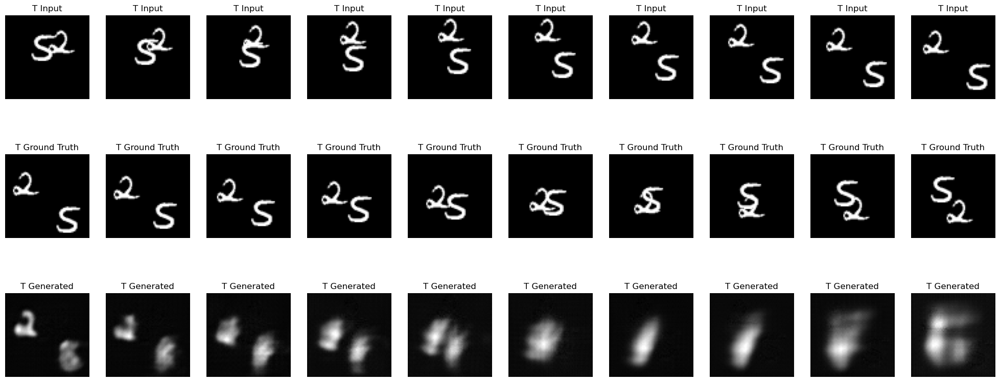

 69%|██████▊   | 300/437 [01:49<00:48,  2.84it/s]

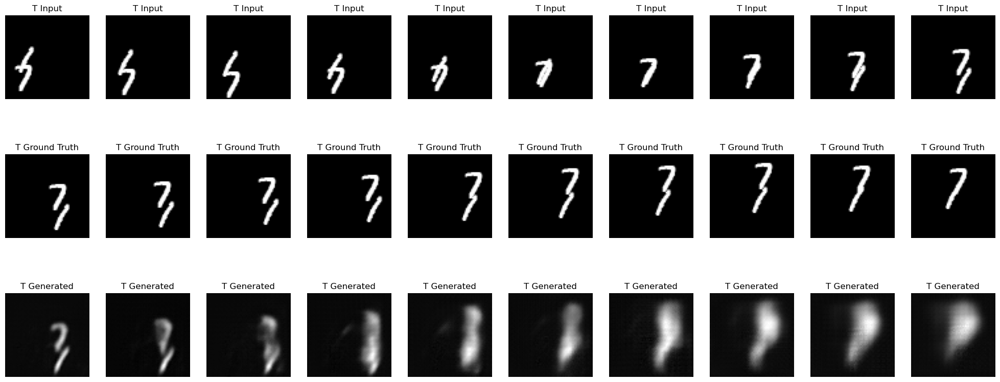

 92%|█████████▏| 400/437 [02:25<00:13,  2.83it/s]

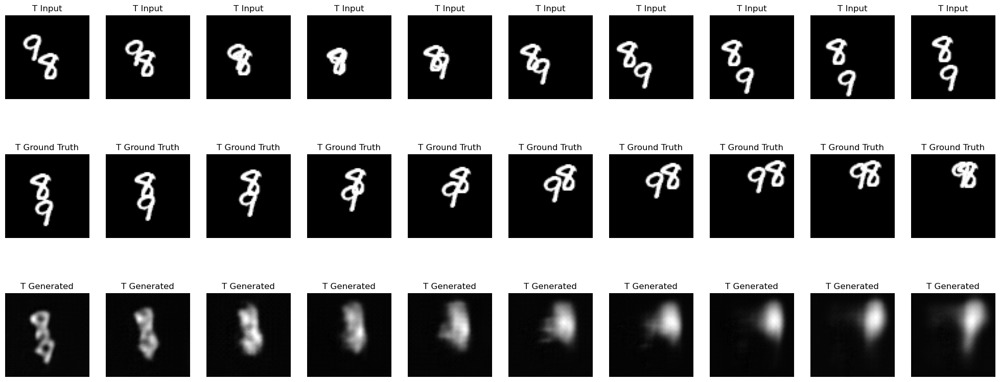

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:5, TL:0.025411133307034418



  0%|          | 0/437 [00:00<?, ?it/s]

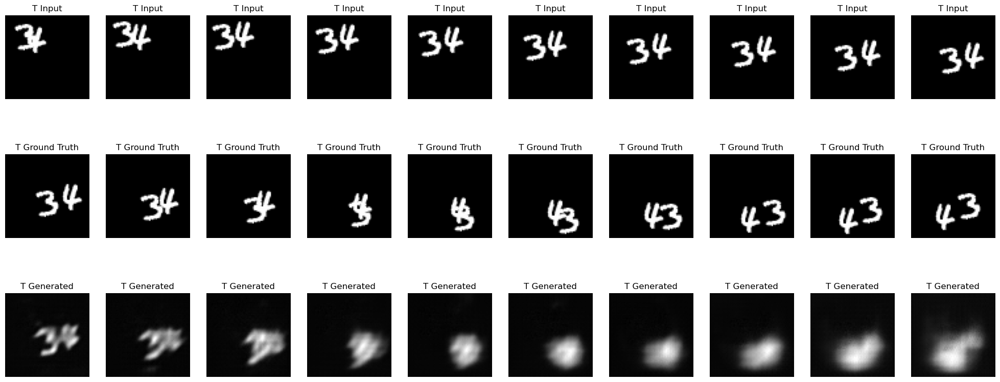

 23%|██▎       | 100/437 [00:36<01:57,  2.86it/s]

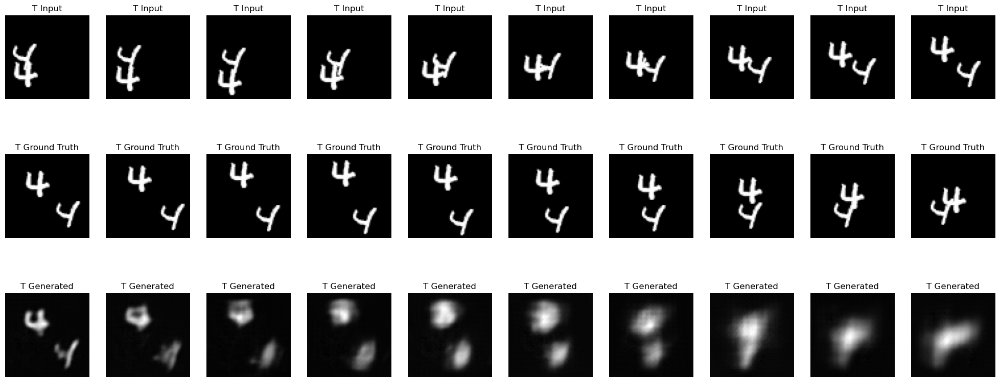

 46%|████▌     | 200/437 [01:12<01:23,  2.83it/s]

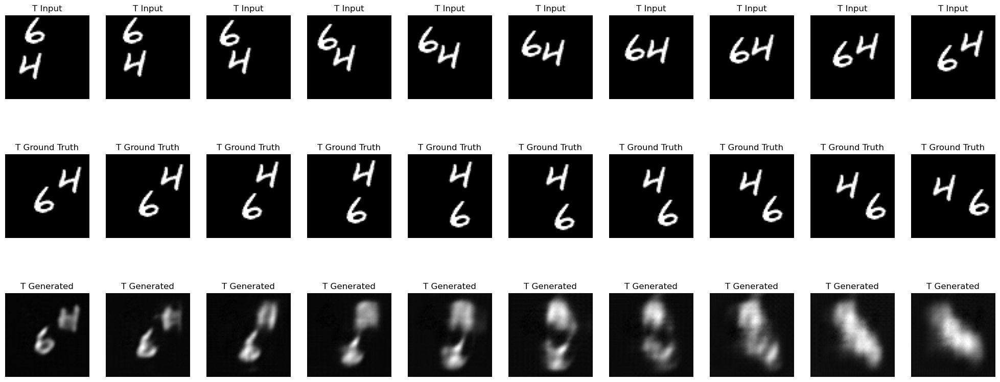

 69%|██████▊   | 300/437 [01:48<00:47,  2.86it/s]

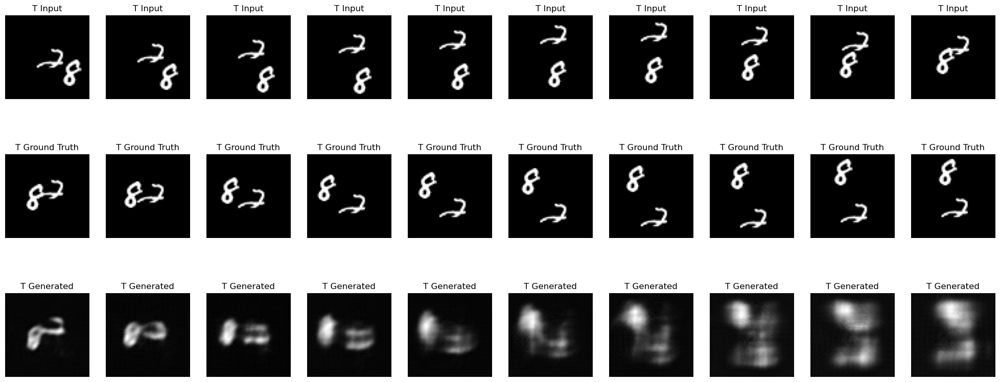

 92%|█████████▏| 400/437 [02:25<00:12,  2.86it/s]

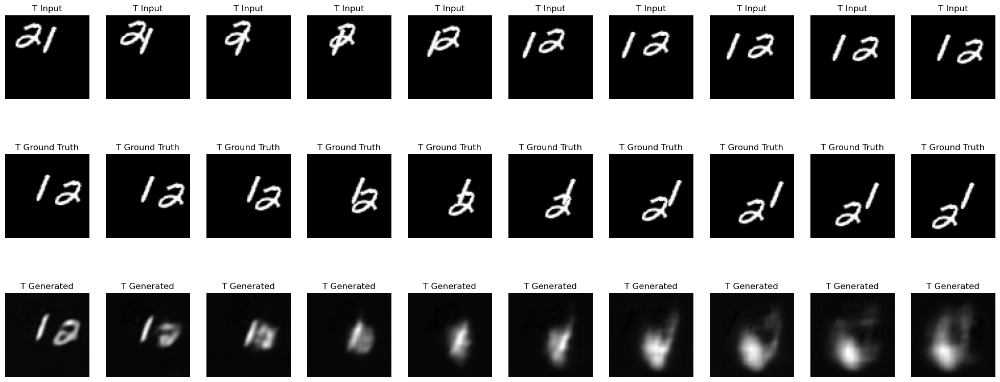

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:6, TL:0.02452260328699713



  0%|          | 0/437 [00:00<?, ?it/s]

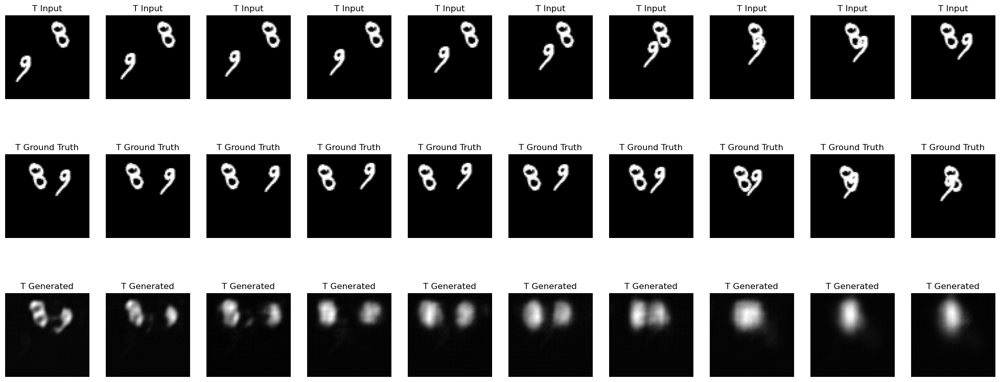

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

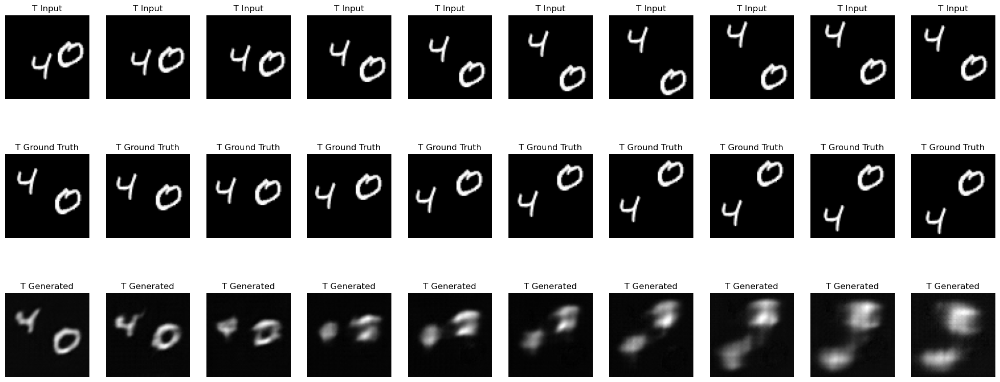

 46%|████▌     | 200/437 [01:12<01:23,  2.85it/s]

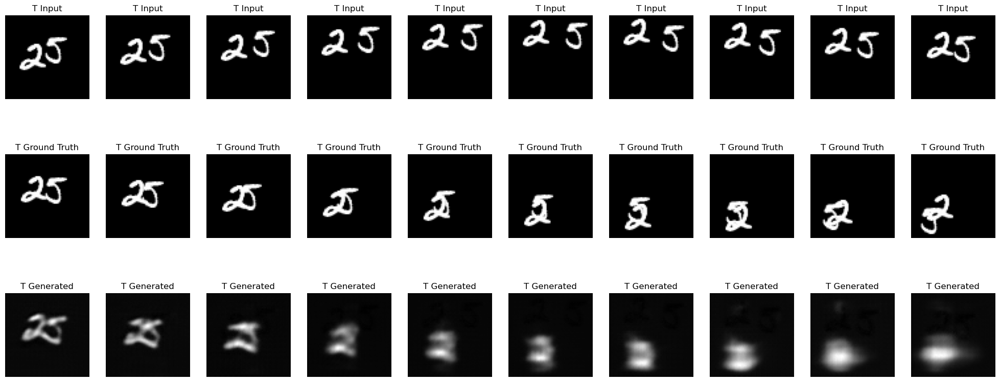

 69%|██████▊   | 300/437 [01:49<00:48,  2.85it/s]

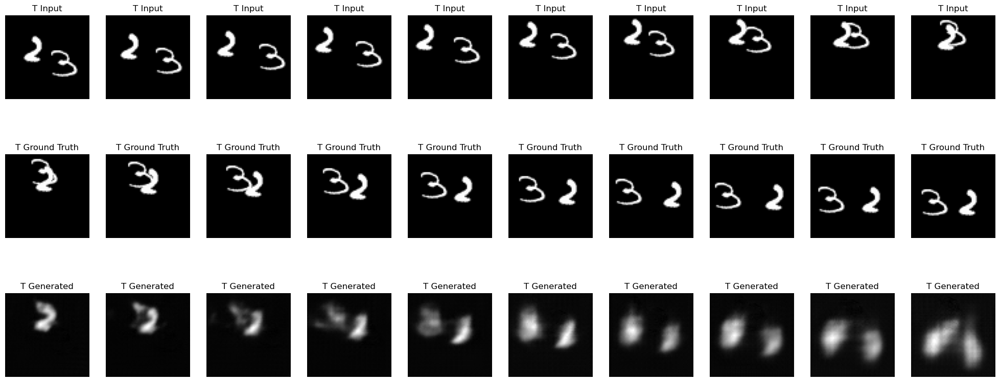

 92%|█████████▏| 400/437 [02:25<00:13,  2.84it/s]

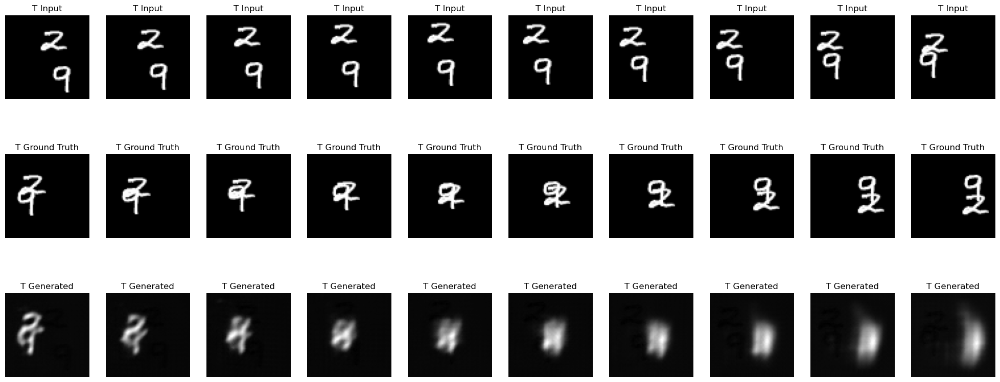

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:7, TL:0.023628157518752926



  0%|          | 0/437 [00:00<?, ?it/s]

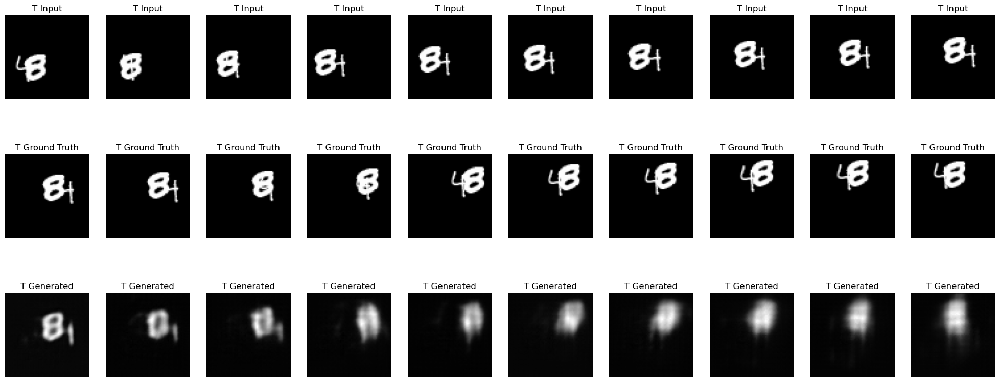

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

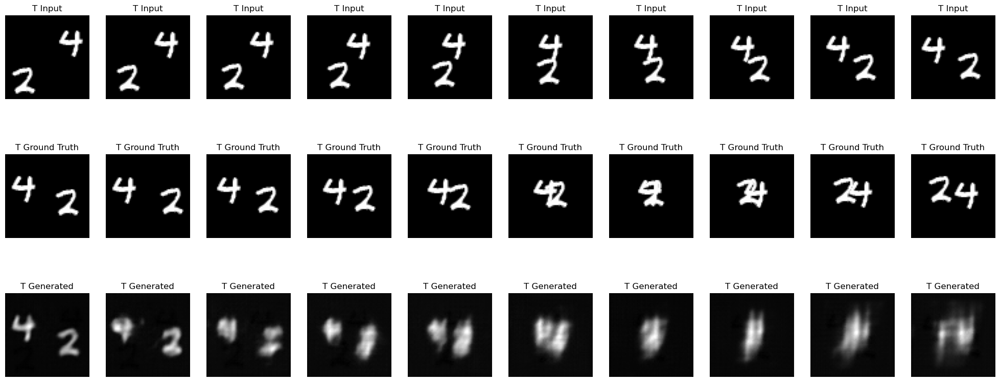

 46%|████▌     | 200/437 [01:12<01:25,  2.77it/s]

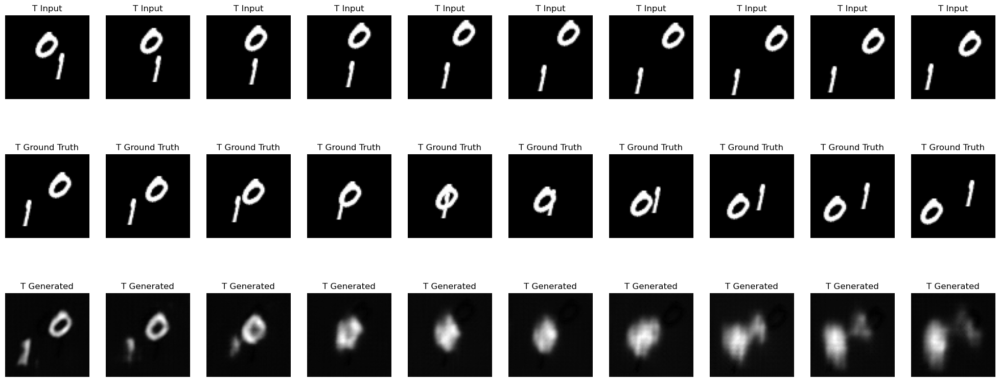

 69%|██████▊   | 300/437 [01:49<00:47,  2.86it/s]

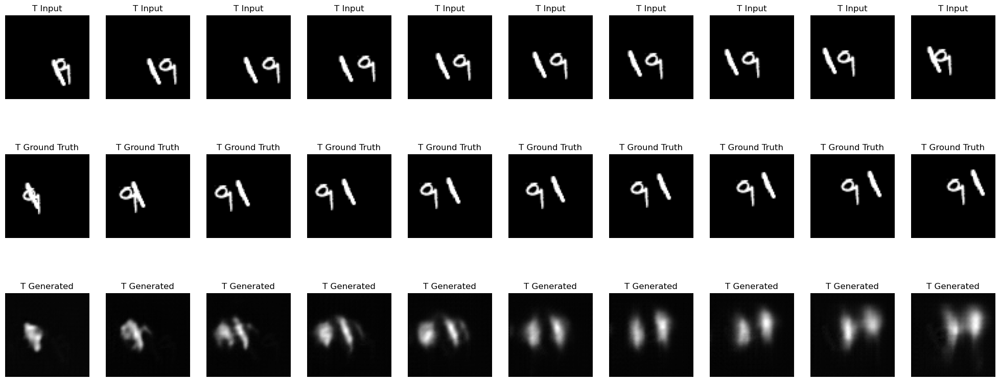

 92%|█████████▏| 400/437 [02:25<00:12,  2.85it/s]

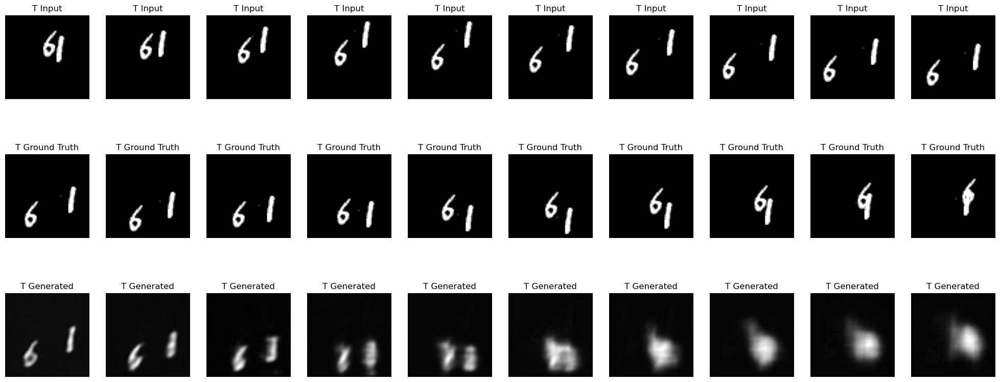

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:8, TL:0.022771714493905106



  0%|          | 0/437 [00:00<?, ?it/s]

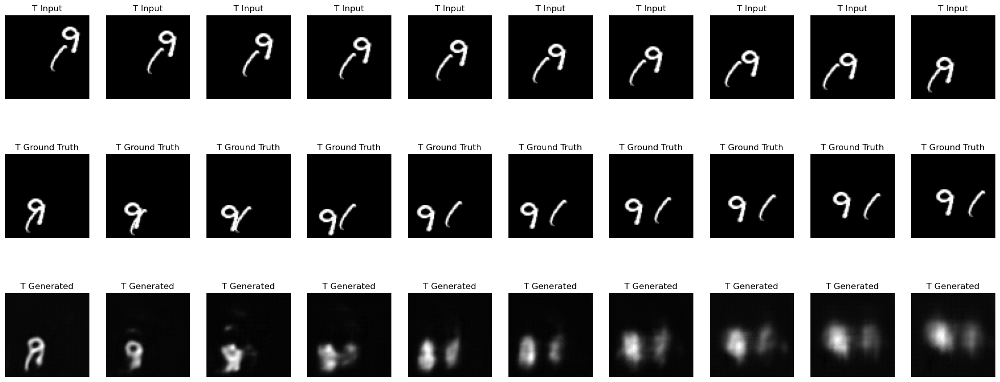

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

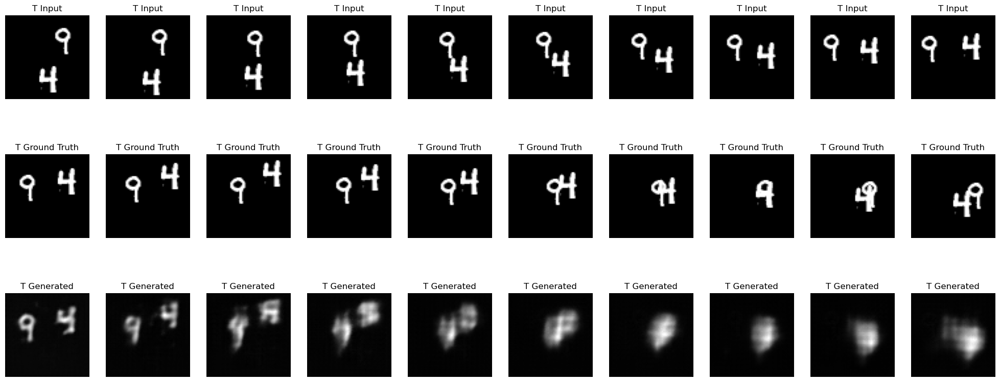

 46%|████▌     | 200/437 [01:12<01:23,  2.85it/s]

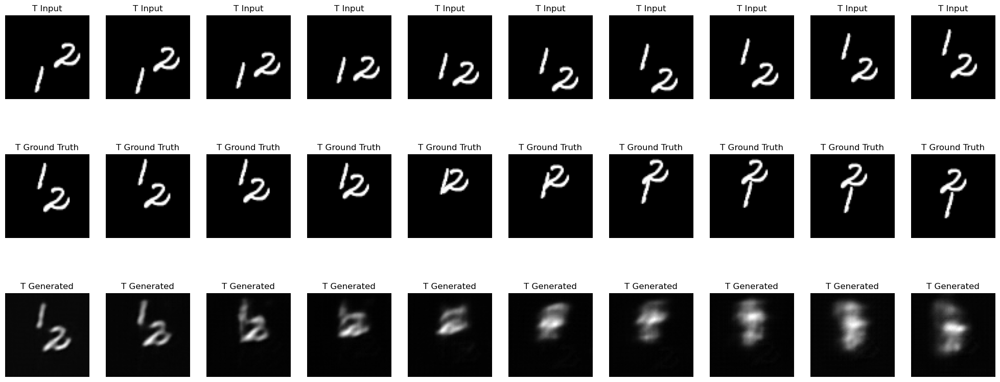

 69%|██████▊   | 300/437 [01:49<00:47,  2.86it/s]

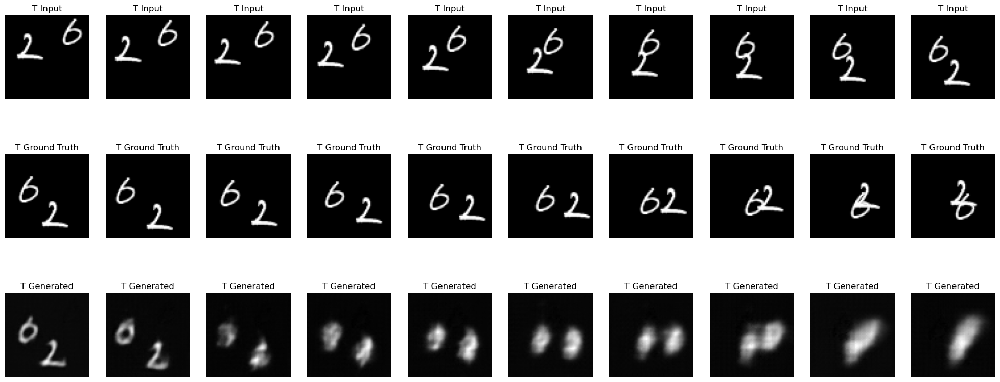

 92%|█████████▏| 400/437 [02:25<00:13,  2.84it/s]

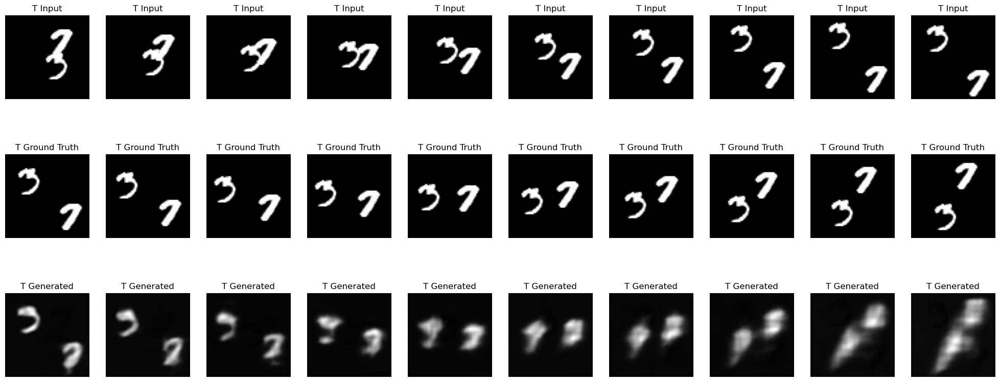

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:9, TL:0.021997975611748086



  0%|          | 0/437 [00:00<?, ?it/s]

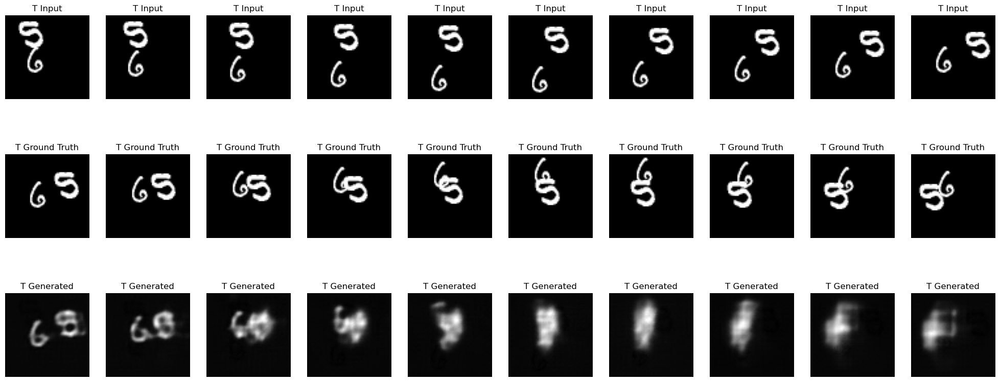

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

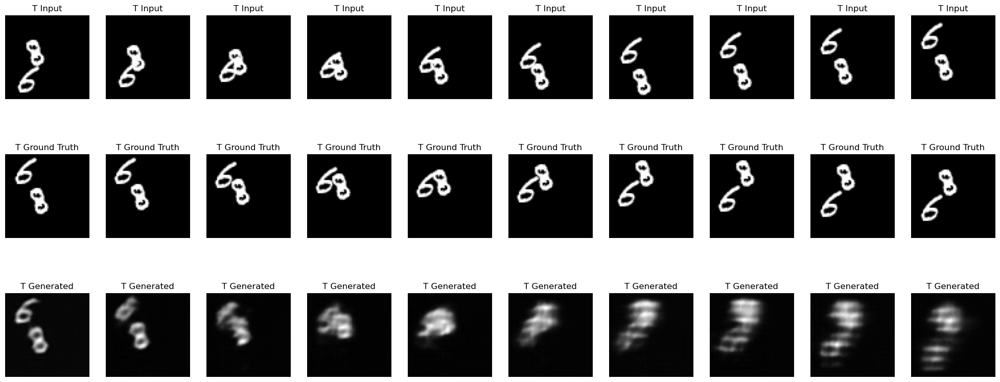

 46%|████▌     | 200/437 [01:12<01:24,  2.79it/s]

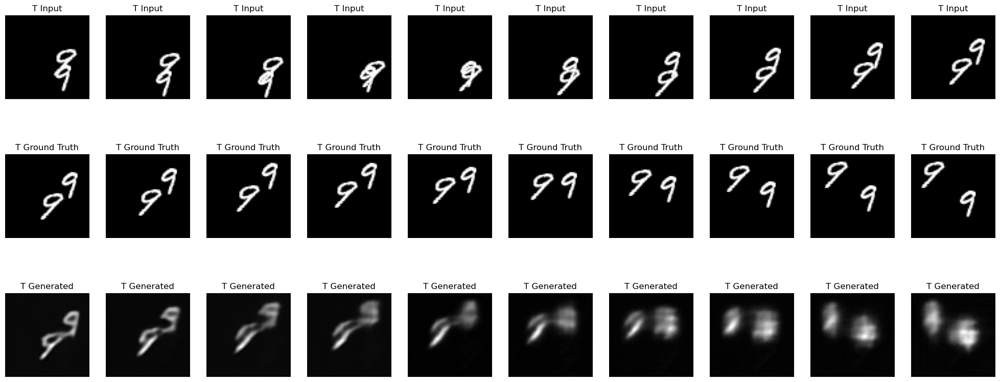

 69%|██████▊   | 300/437 [01:48<00:48,  2.85it/s]

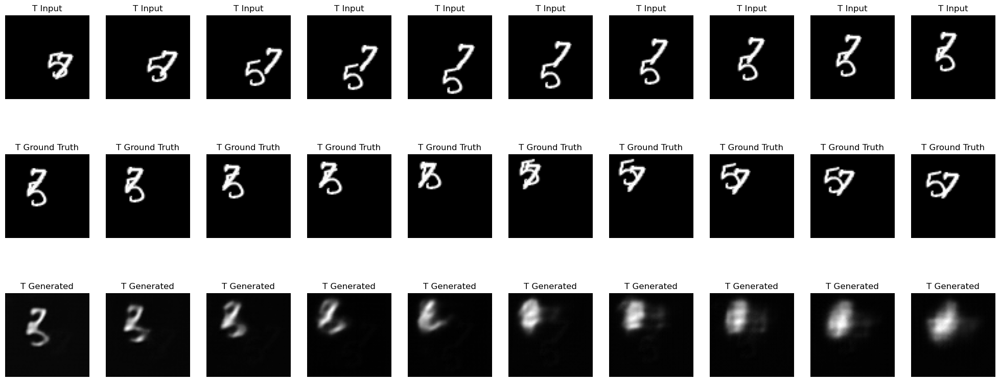

 92%|█████████▏| 400/437 [02:25<00:12,  2.86it/s]

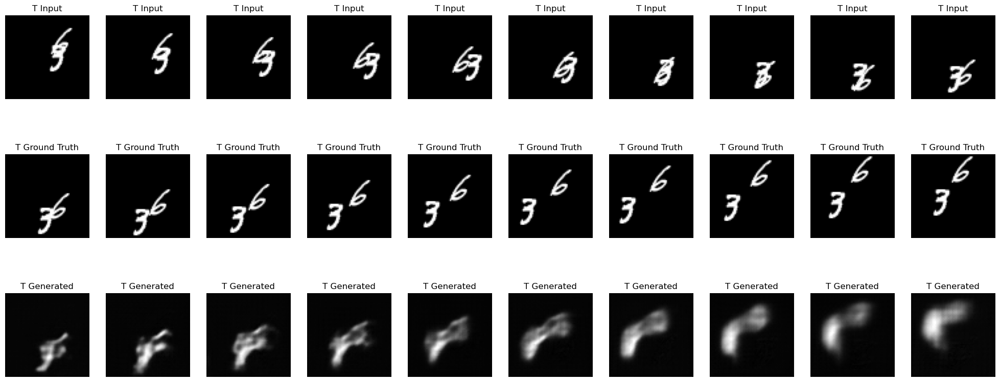

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:10, TL:0.021255330751635118



  0%|          | 0/437 [00:00<?, ?it/s]

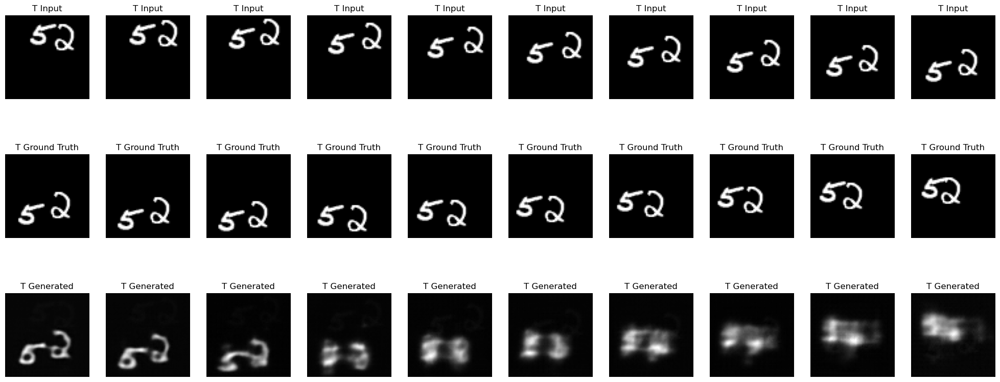

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

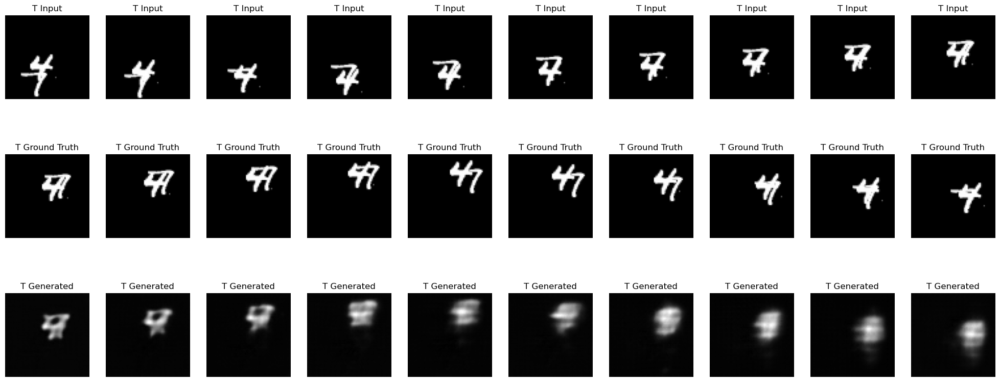

 46%|████▌     | 200/437 [01:12<01:22,  2.86it/s]

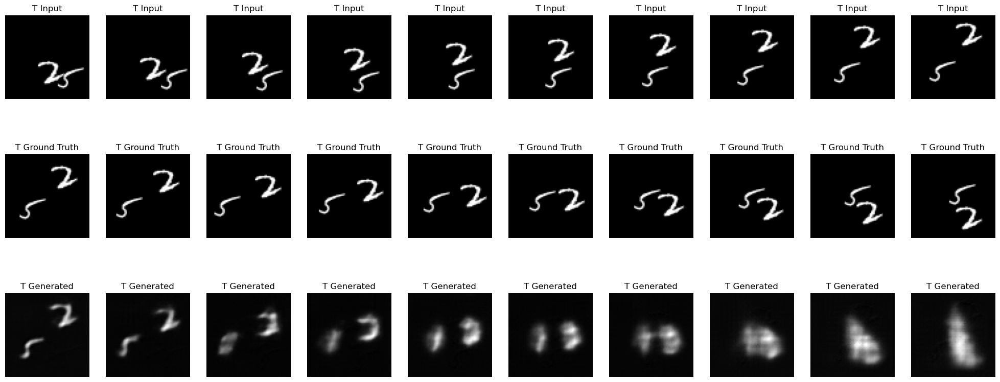

 69%|██████▊   | 300/437 [01:48<00:47,  2.85it/s]

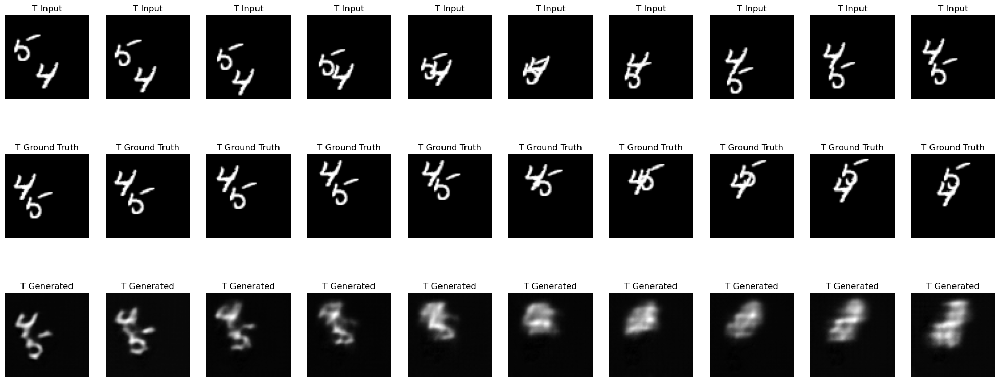

 92%|█████████▏| 400/437 [02:25<00:13,  2.82it/s]

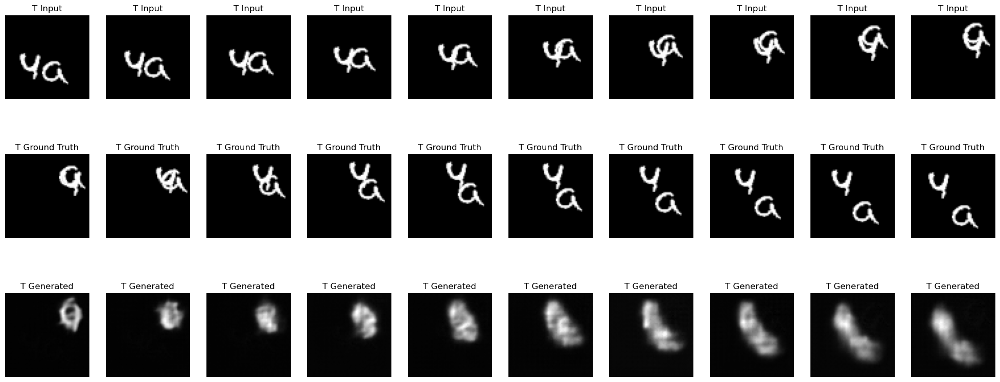

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:11, TL:0.020534303985553146



  0%|          | 0/437 [00:00<?, ?it/s]

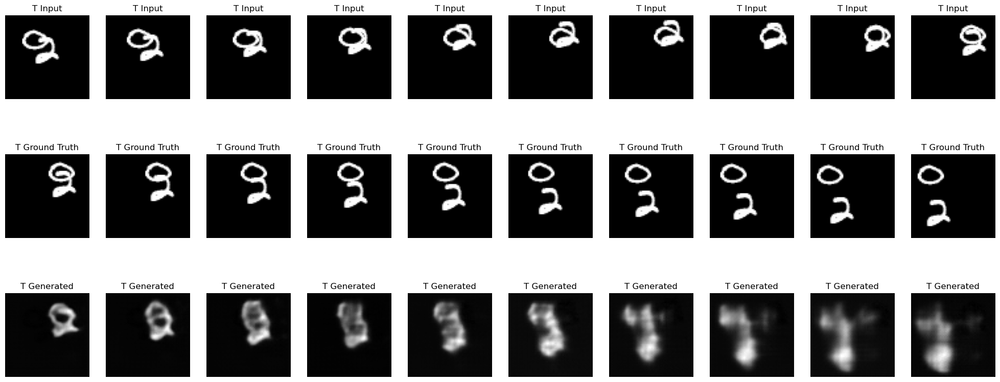

 23%|██▎       | 100/437 [00:36<01:57,  2.86it/s]

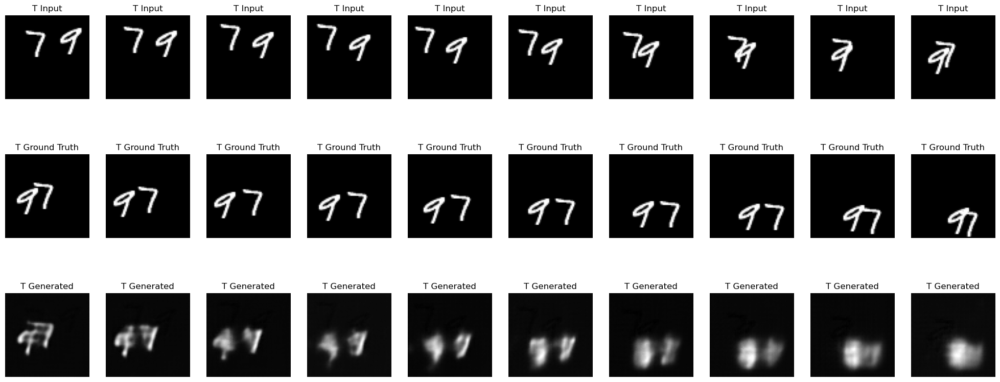

 46%|████▌     | 200/437 [01:12<01:24,  2.81it/s]

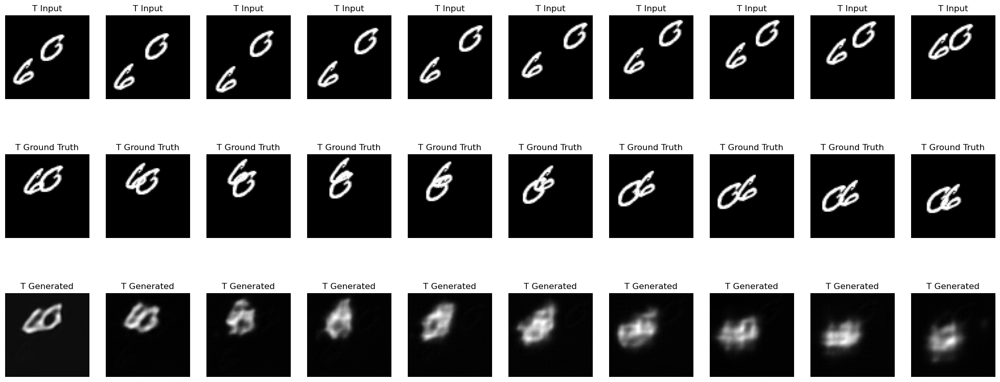

 69%|██████▊   | 300/437 [01:48<00:48,  2.85it/s]

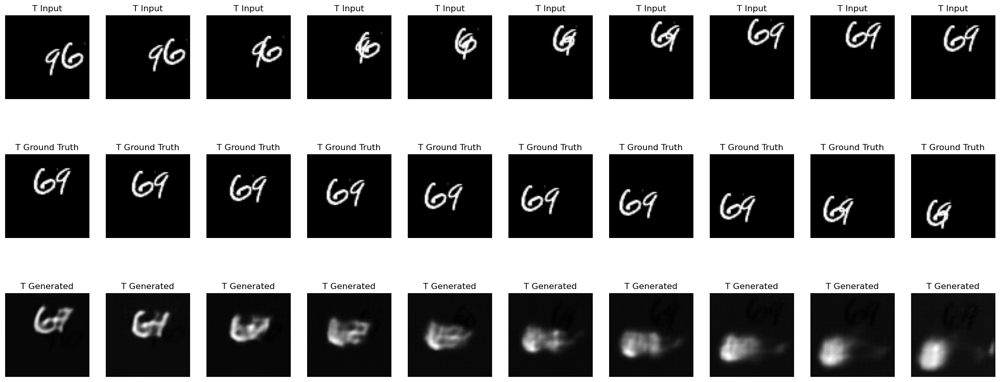

 92%|█████████▏| 400/437 [02:25<00:12,  2.85it/s]

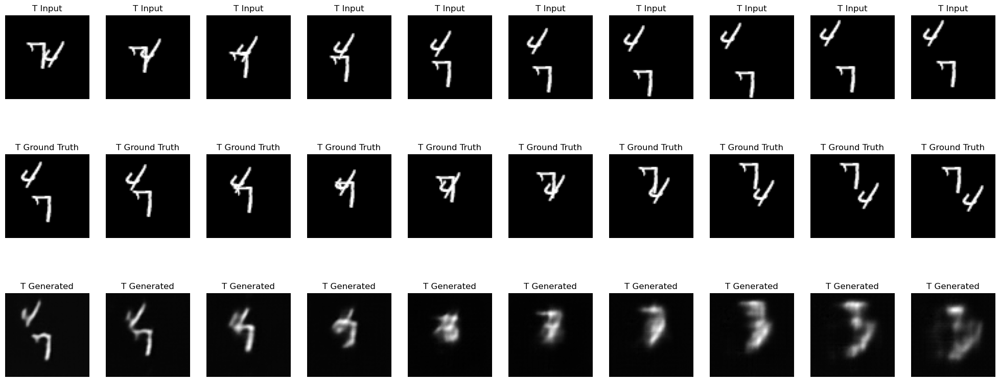

100%|██████████| 437/437 [02:39<00:00,  2.74it/s]

E:12, TL:0.019889059478685567



  0%|          | 0/437 [00:00<?, ?it/s]

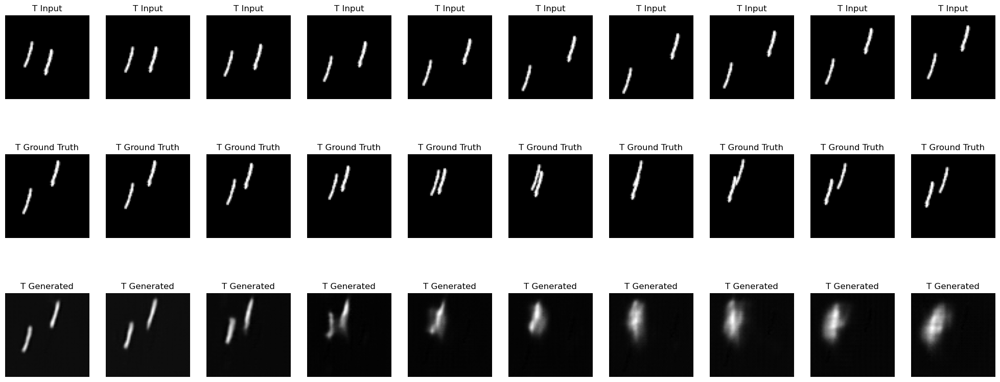

 23%|██▎       | 100/437 [00:36<01:58,  2.85it/s]

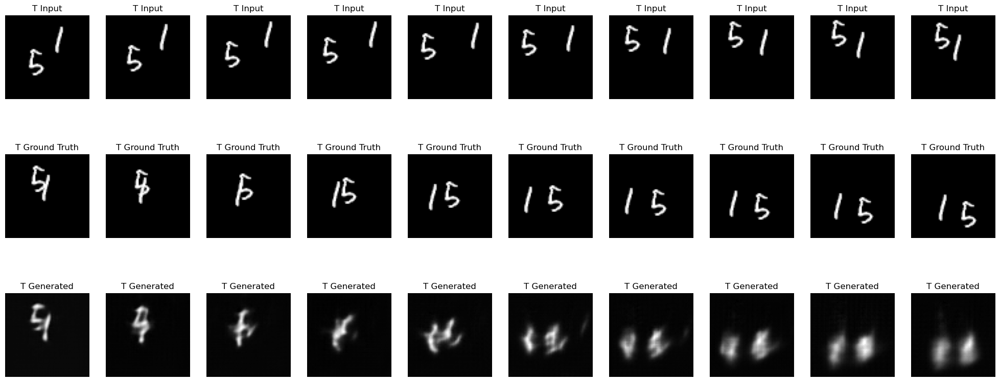

 46%|████▌     | 200/437 [01:12<01:23,  2.85it/s]

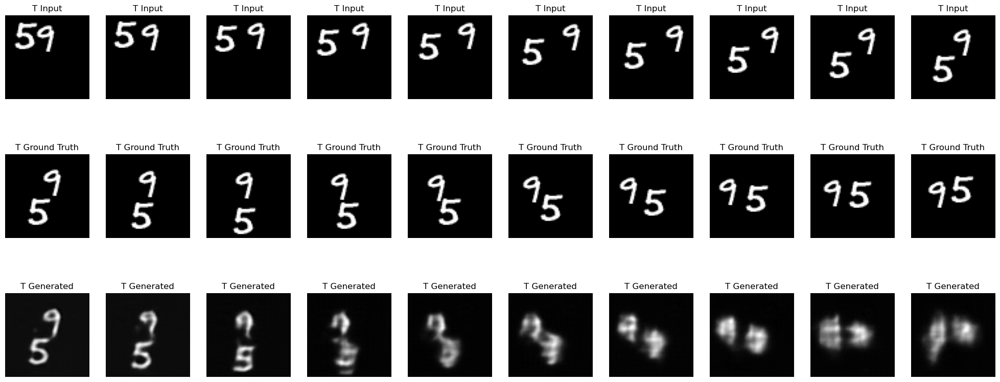

 69%|██████▊   | 300/437 [01:49<00:47,  2.86it/s]

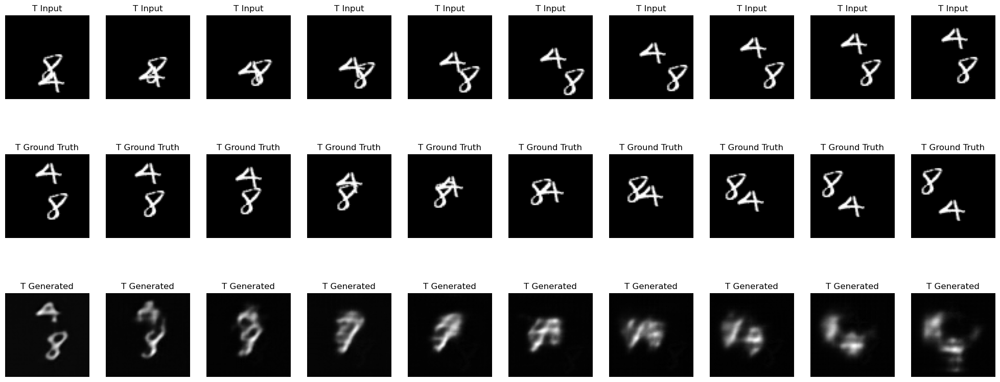

 92%|█████████▏| 400/437 [02:25<00:13,  2.83it/s]

In [ ]:
exp = Exp(opt)
exp.train(args)

In [ ]:
#evaluation_proper(test_loader, exp.model)